In [1]:
%load_ext autoreload
%autoreload 2

In [24]:
import os

import pickle

import numpy as np

import matplotlib
import matplotlib.pyplot as plt

from modules.utils.general_utils.utilities import group_wise_binning
from modules.utils.general_utils.visualizers import visualize_full_panel, visualize_game_specific_panel

In [3]:
INPUTS_PATH = 'data\\train\\inputs\\{}'
TARGETS_PATH = 'data\\train\\targets\\{}'

CMAP = matplotlib.cm.get_cmap('Paired')
ERROR_CMAP = matplotlib.cm.get_cmap('Reds')

SNAPSHOTS = 4

TARGETS = [
    'tar_sessions',
    'tar_delta_sessions',    
    'tar_active_time',
    'tar_session_time',
    'tar_activity'
]

with open('results\\saved_objects\\saved_data_containers\\rnn_vs_env_even.pkl', 'rb') as infile:
    container = pickle.load(infile)

In [4]:
TARGETS_RMP = {
    'tar_delta_sessions': 'Future Absence',    
    'tar_active_time': 'Future Active Time',
    'tar_session_time': 'Future Session Time',
    'tar_activity': 'Future Session Activity',
    'tar_sessions': 'Future N° Sessions'
}
with open('results\\saved_objects\\mappers\\context.pkl', 'rb') as pickle_file:
    CONTEXT_RMP = pickle.load(pickle_file) 
CONTEXT_RMP = {value: key for key, value in CONTEXT_RMP.items()}

# -------------- PREDICTED INTENSITY FUTURE INTERACTIONS ----------------------

## BASIC MODEL

### BEHAVIOURAL REPRESENTATION / PLAYER STATE

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning

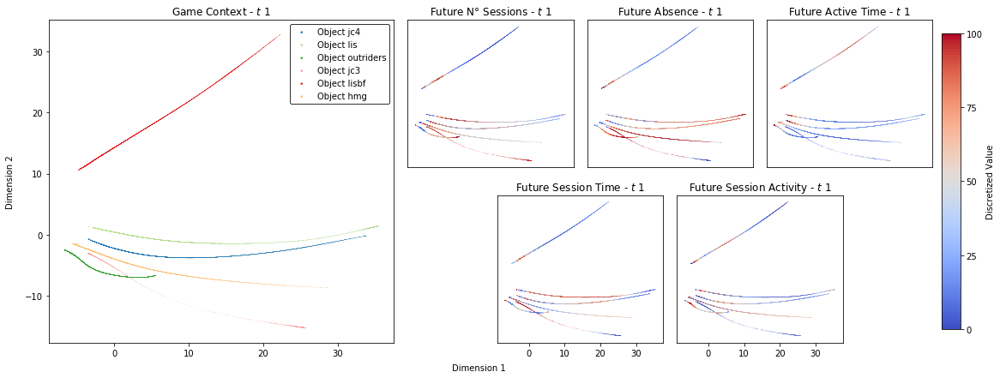

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


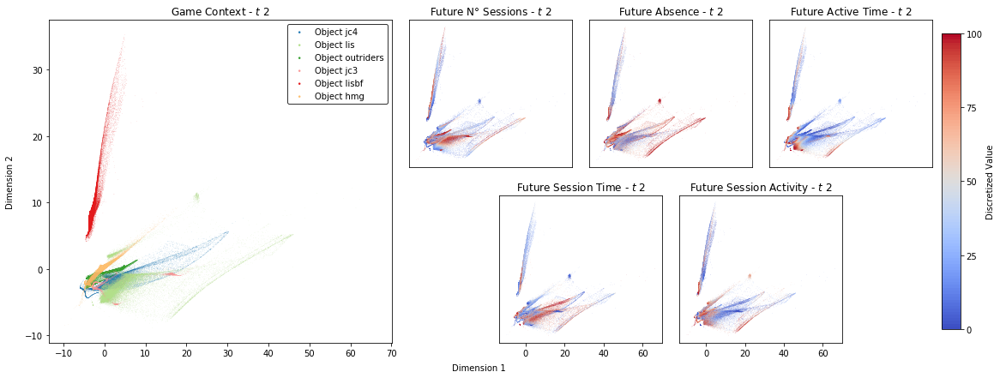

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


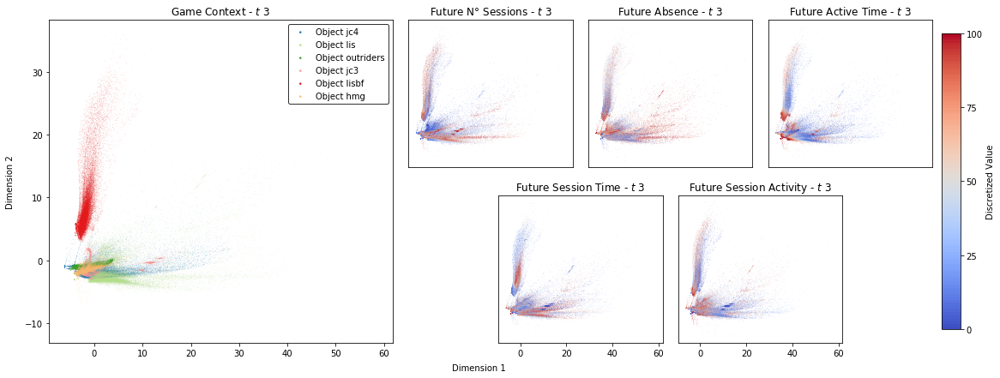

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


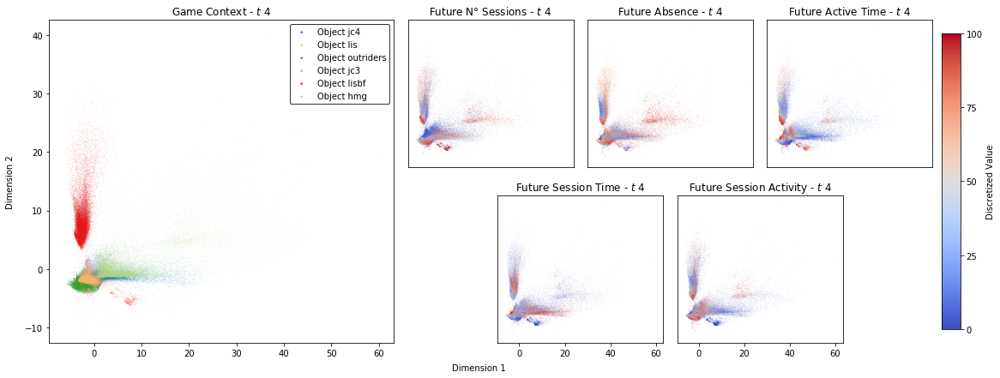

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning

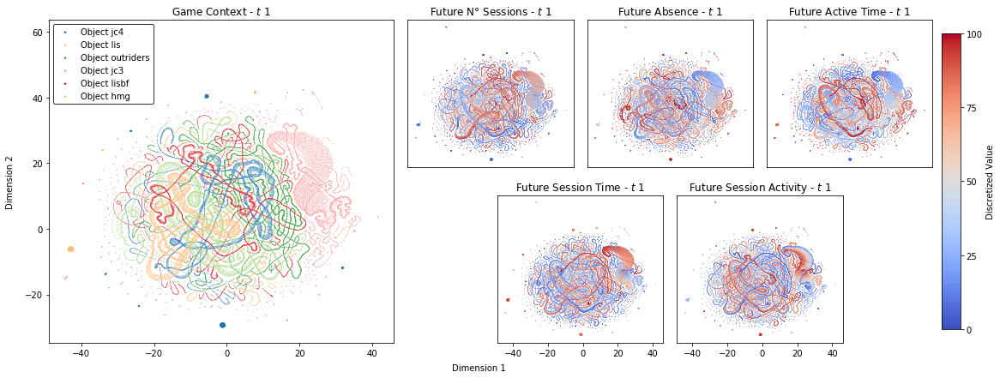

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


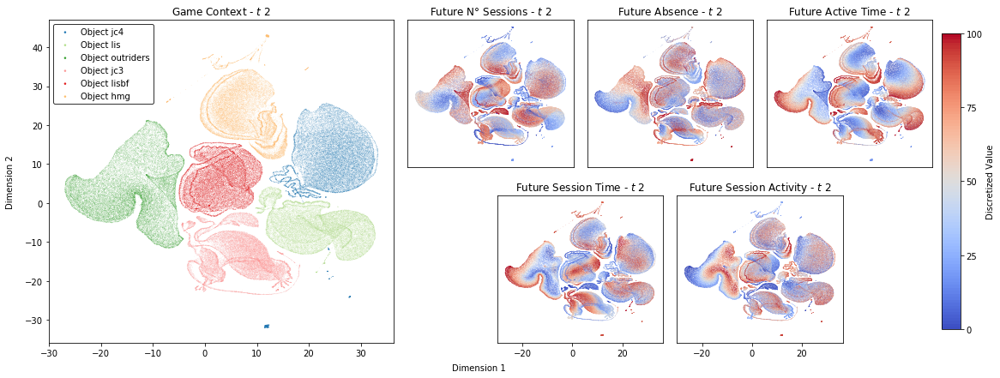

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


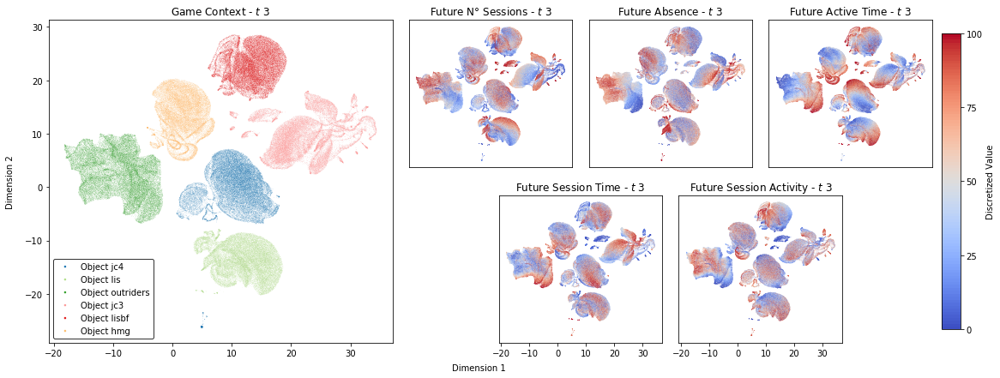

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


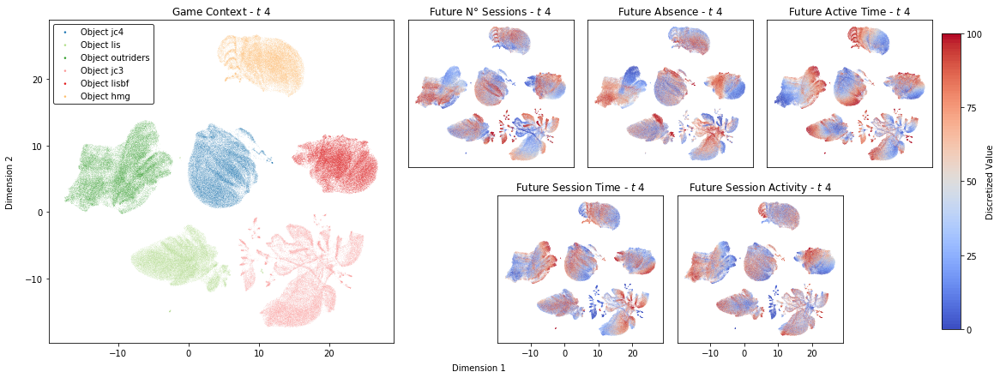

In [6]:
for reduction_type in ['pca', 'umap']:
    
    for snapshot in range(4):

        reduction = np.load(f'results\\saved_dim_reduction\\RNN_0_lstm_layer_features\\2D\\{reduction_type}{snapshot}.npy')
        reduction = reduction[~np.isnan(reduction).any(axis=1)]
        colors_dict = {target_name: None for target_name in TARGETS}

        for color_name, array in colors_dict.items():

            binned_array = group_wise_binning(
                array=container['prediction']['RNN'][color_name][snapshot],
                grouper=container['context'][snapshot],
                n_bins=100,
                method='discret'
            )
            colors_dict[color_name] = binned_array

        visualize_full_panel(
            reduction=reduction, 
            contexts=container['context'][snapshot],
            context_remap=CONTEXT_RMP,
            colors_dict=colors_dict, 
            colors_remap=TARGETS_RMP,
            colors_name=TARGETS, 
            cmapper=CMAP,
            snapshot=snapshot+1,
            save_name=f'basic_umap_state_{snapshot}',
            s=0.1
        )

## FULL MODEL

### BEHAVIOURAL REPRESENTATION

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


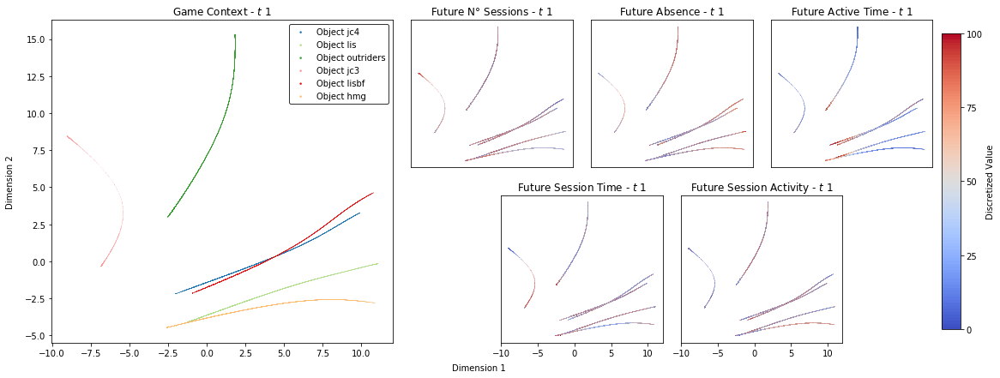

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


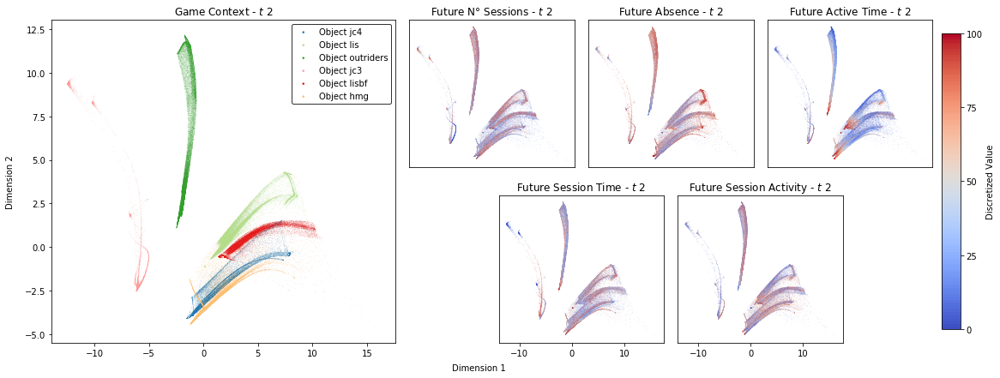

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


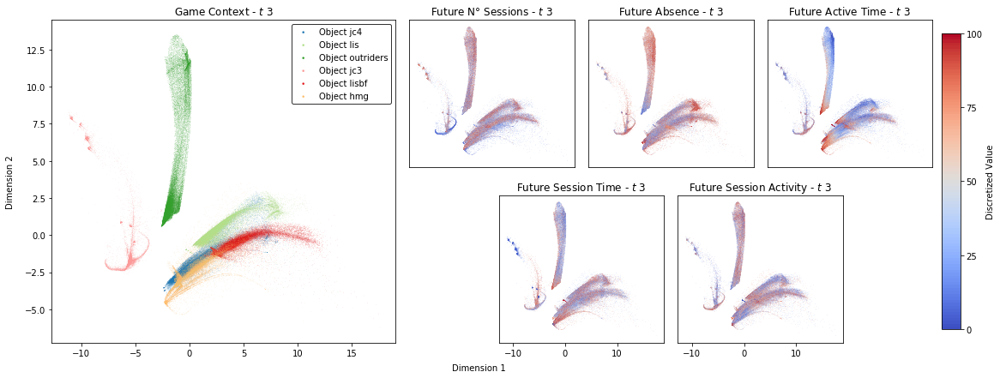

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


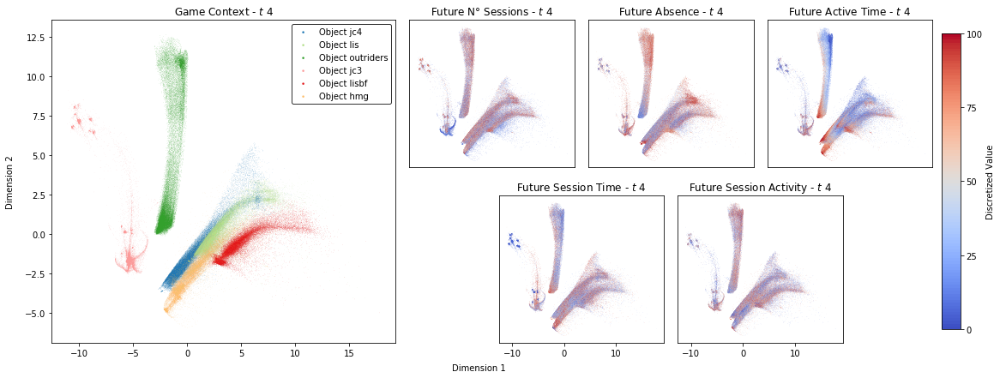

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


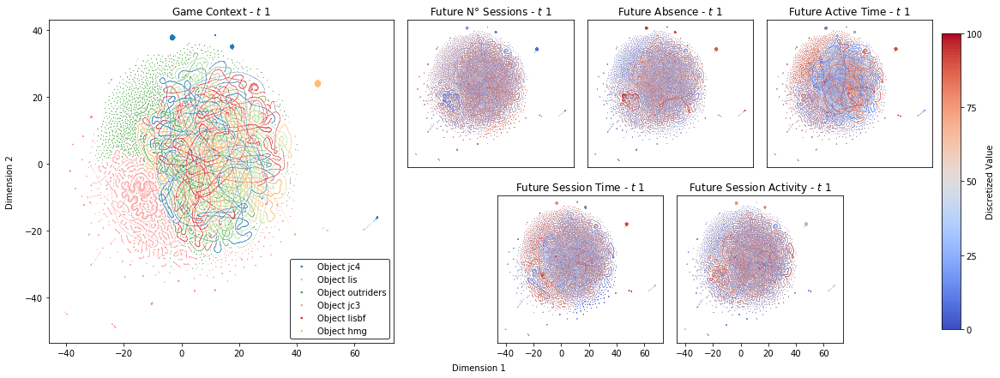

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


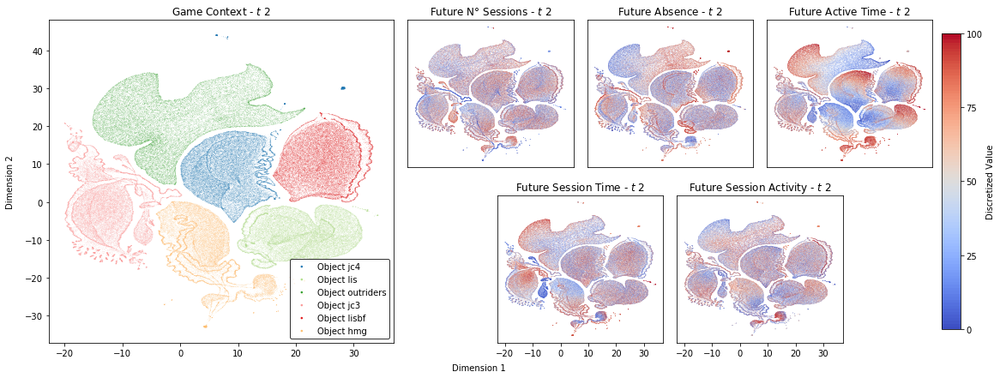

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


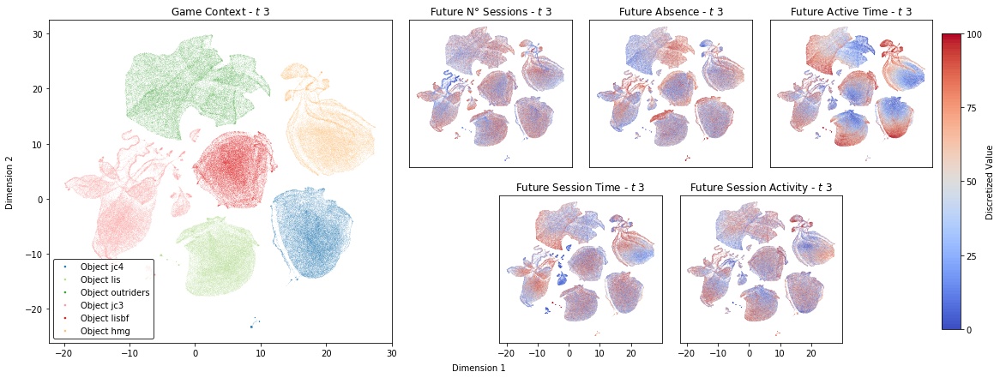

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


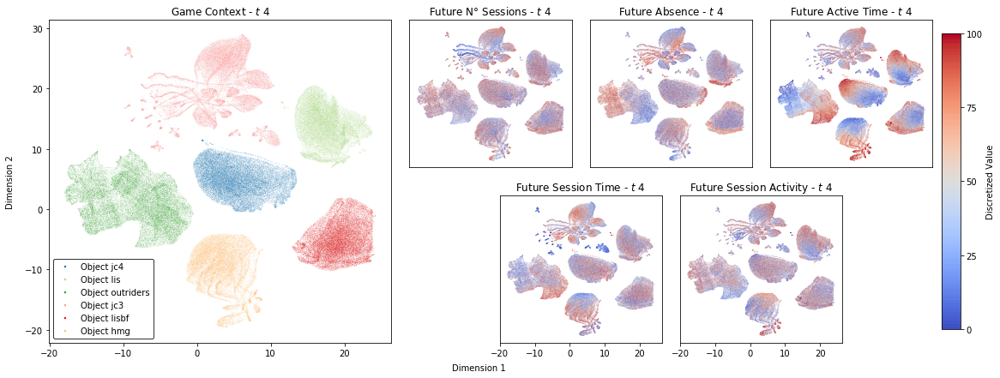

In [7]:
for reduction_type in ['pca', 'umap']:
    
    for snapshot in range(4):

        reduction = np.load(f'results\\saved_dim_reduction\\RNN_env_even_0_lstm_layer_features\\2D\\{reduction_type}{snapshot}.npy')
        reduction = reduction[~np.isnan(reduction).any(axis=1)]
        colors_dict = {target_name: None for target_name in TARGETS}

        for color_name, array in colors_dict.items():

            binned_array = group_wise_binning(
                array=container['prediction']['RNN_env_even'][color_name][snapshot],
                grouper=container['context'][snapshot],
                n_bins=100,
                method='discret'
            )
            colors_dict[color_name] = binned_array

        visualize_full_panel(
            reduction=reduction, 
            contexts=container['context'][snapshot],
            context_remap=CONTEXT_RMP,
            colors_dict=colors_dict, 
            colors_remap=TARGETS_RMP,
            colors_name=TARGETS, 
            cmapper=CMAP,
            snapshot=snapshot+1,
            save_name=f'full_umap_beh_{snapshot}',
            s=0.1
        )

### ENVIRONMENT REPRESENTATION

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


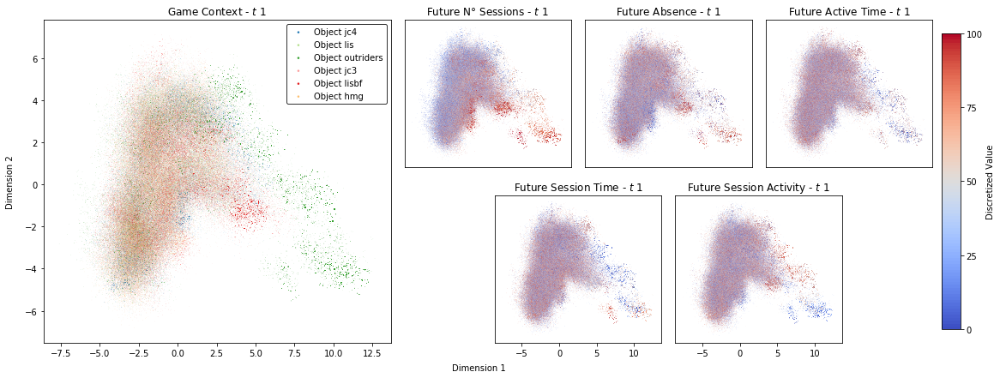

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


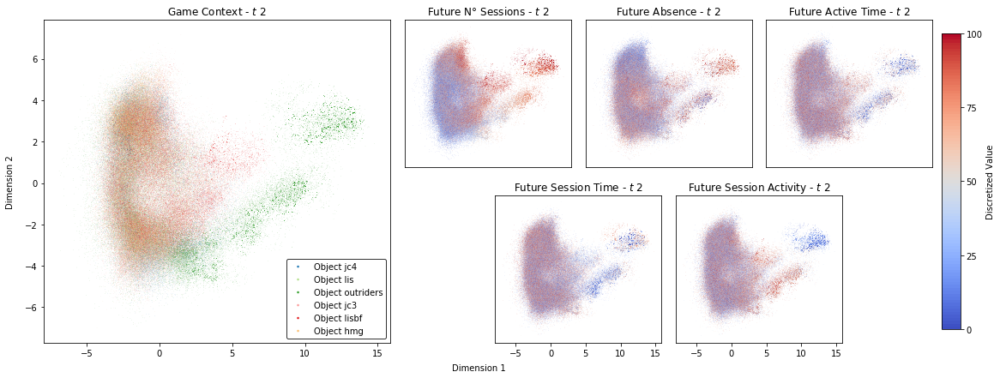

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


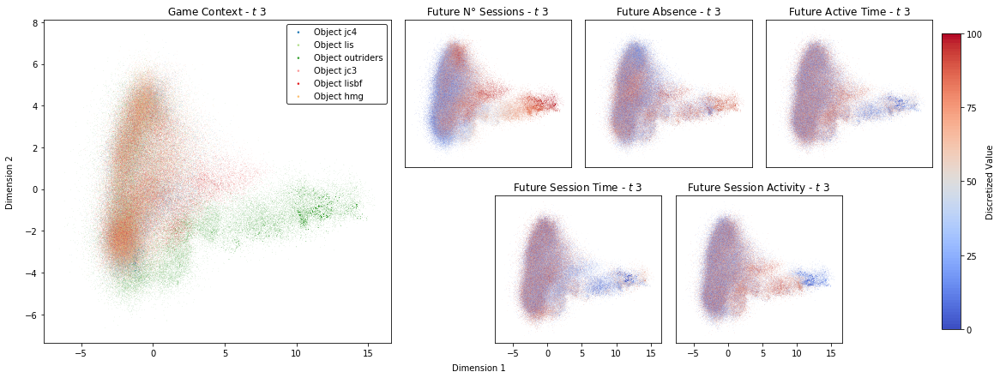

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


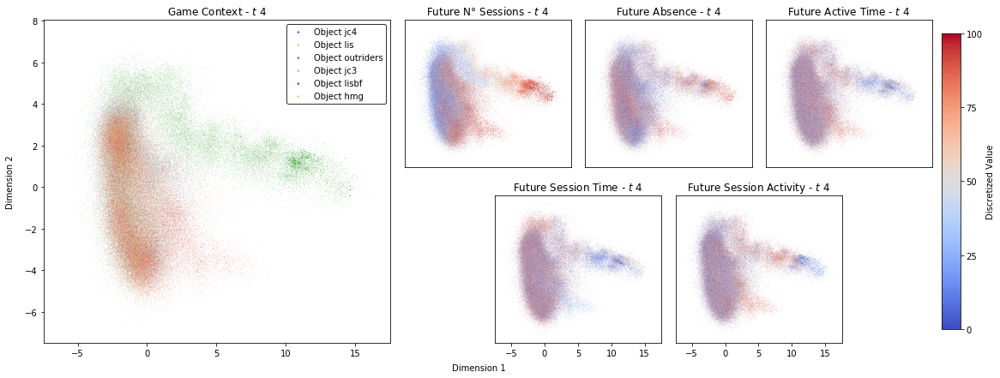

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


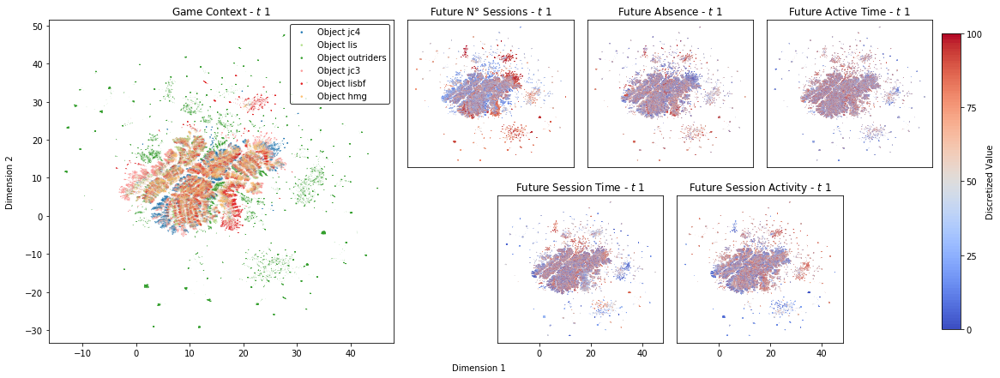

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


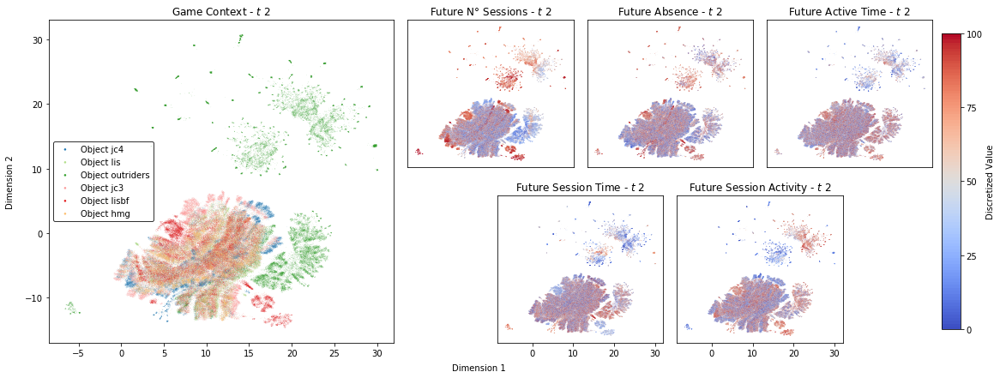

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


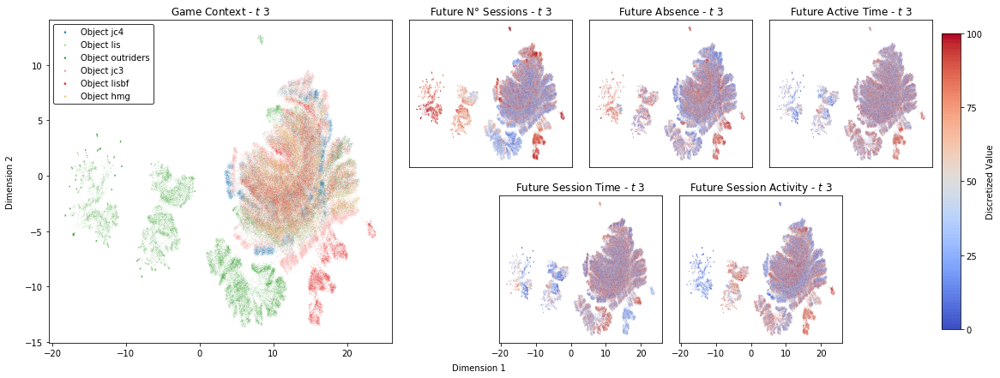

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


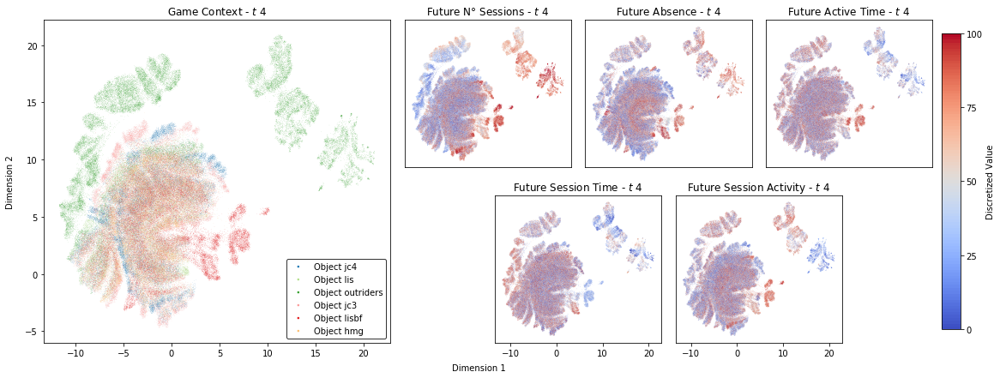

In [8]:
for reduction_type in ['pca', 'umap']:
    
    for snapshot in range(4):

        reduction = np.load(f'results\\saved_dim_reduction\\RNN_env_even_0_lstm_layer_env\\2D\\{reduction_type}{snapshot}.npy')
        reduction = reduction[~np.isnan(reduction).any(axis=1)]
        colors_dict = {target_name: None for target_name in TARGETS}

        for color_name, array in colors_dict.items():

            binned_array = group_wise_binning(
                array=container['prediction']['RNN_env_even'][color_name][snapshot],
                grouper=container['context'][snapshot],
                n_bins=100,
                method='discret'
            )
            colors_dict[color_name] = binned_array

        visualize_full_panel(
            reduction=reduction, 
            contexts=container['context'][snapshot],
            context_remap=CONTEXT_RMP,
            colors_dict=colors_dict, 
            colors_remap=TARGETS_RMP,
            colors_name=TARGETS, 
            cmapper=CMAP,
            snapshot=snapshot+1,
            save_name=f'full_umap_env_{snapshot}',
            s=0.1
        )

### GAME EVENTS REPRESENTATION

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


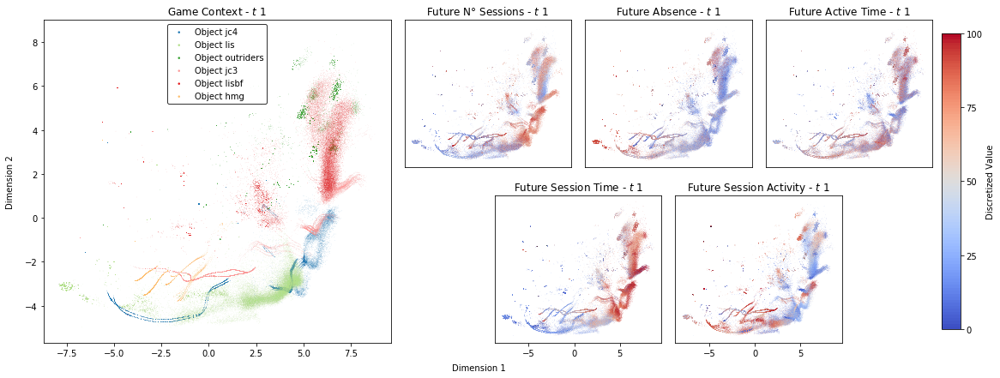

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


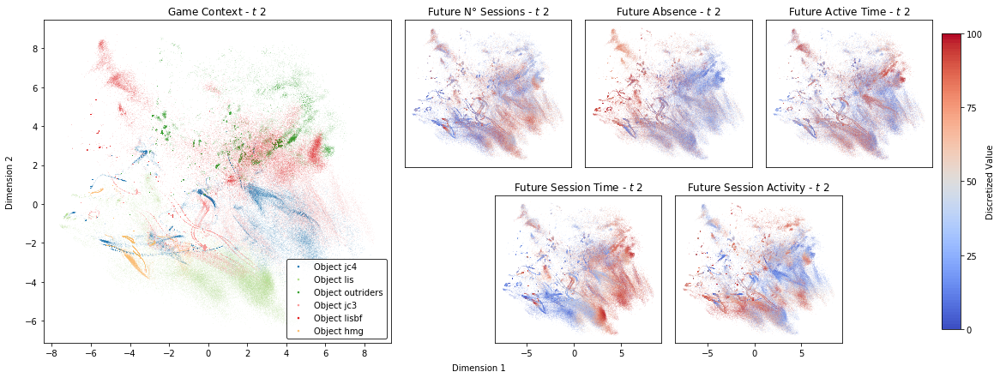

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


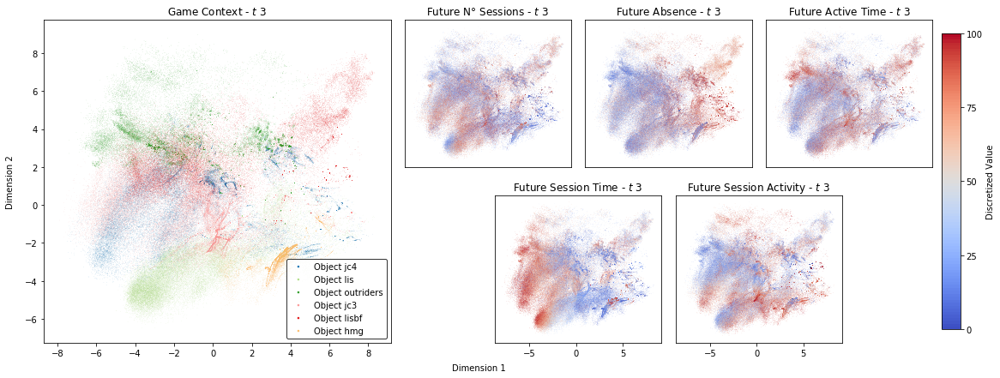

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


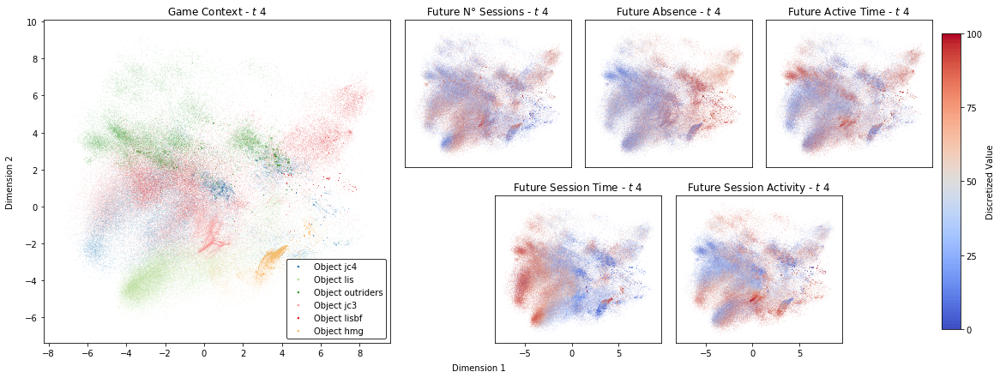

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


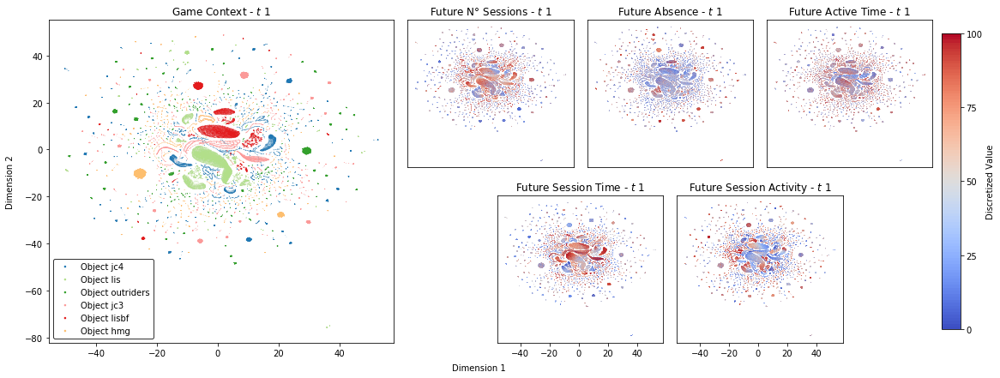

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


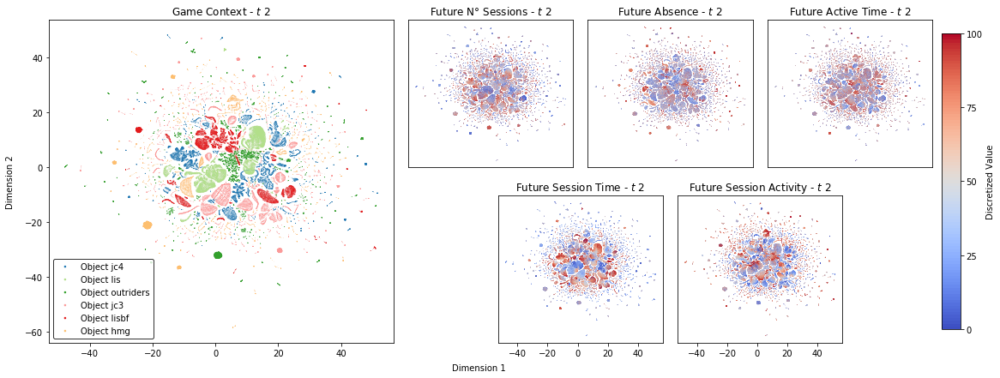

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


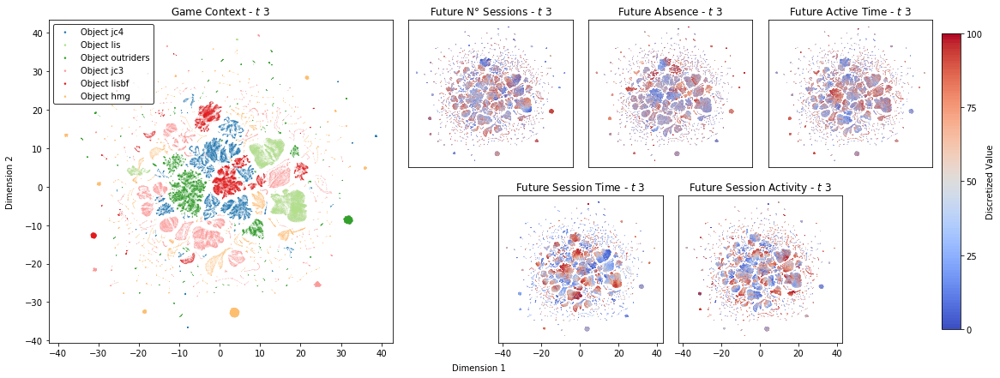

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


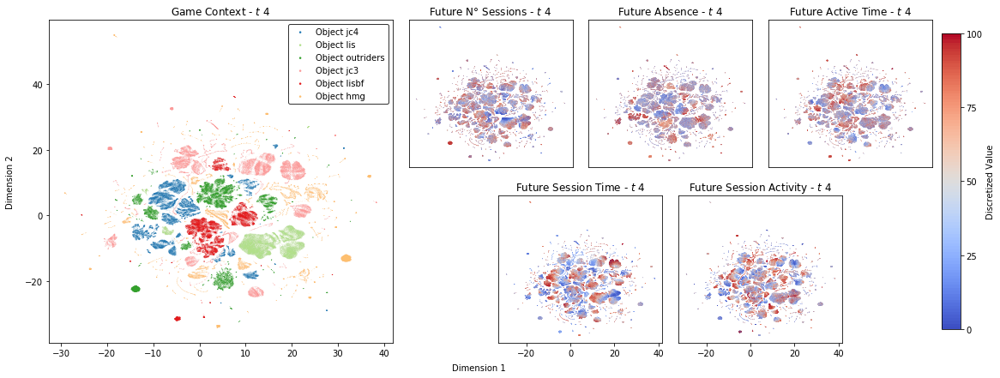

In [9]:
for reduction_type in ['pca', 'umap']:
    
    for snapshot in range(4):

        reduction = np.load(f'results\\saved_dim_reduction\\RNN_env_even_0_lstm_layer_events\\2D\\{reduction_type}{snapshot}.npy')
        reduction = reduction[~np.isnan(reduction).any(axis=1)]
        colors_dict = {target_name: None for target_name in TARGETS}

        for color_name, array in colors_dict.items():

            binned_array = group_wise_binning(
                array=container['prediction']['RNN_env_even'][color_name][snapshot],
                grouper=container['context'][snapshot],
                n_bins=100,
                method='discret'
            )
            colors_dict[color_name] = binned_array

        visualize_full_panel(
            reduction=reduction, 
            contexts=container['context'][snapshot],
            context_remap=CONTEXT_RMP,
            colors_dict=colors_dict, 
            colors_remap=TARGETS_RMP,
            colors_name=TARGETS, 
            cmapper=CMAP,
            snapshot=snapshot+1,
            save_name=f'full_umap_even_{snapshot}',
            s=0.1
        )

### PLAYER STATE

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


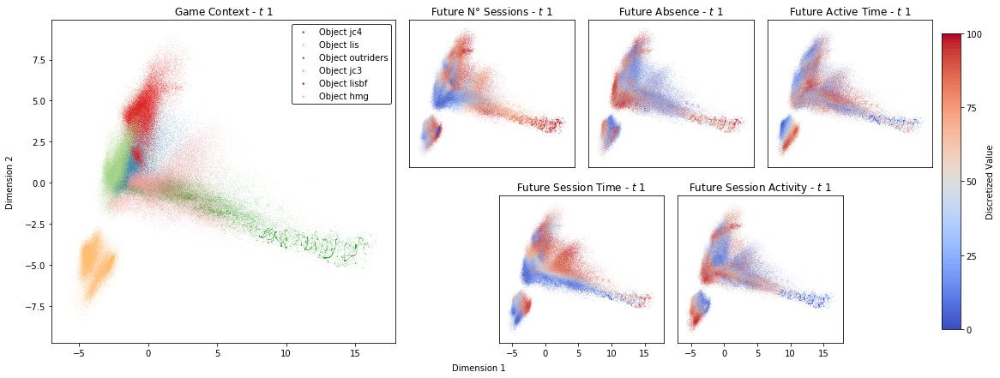

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


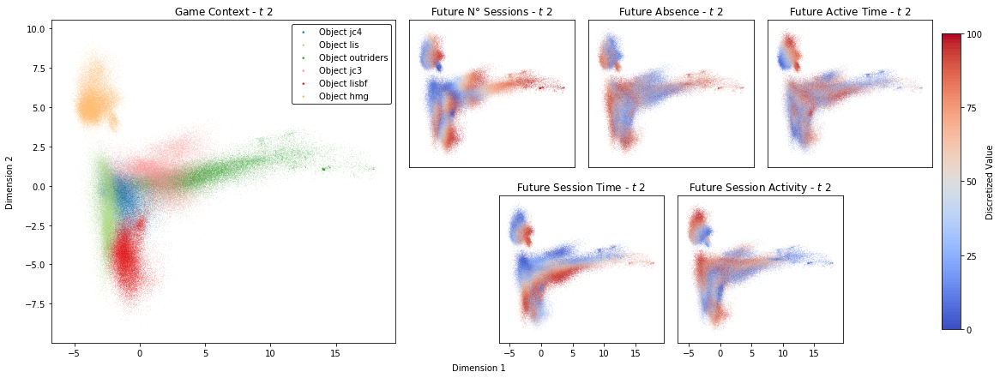

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


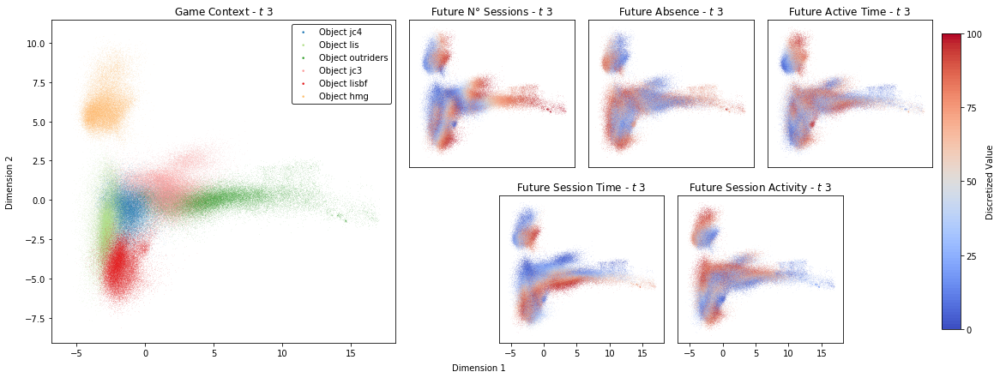

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


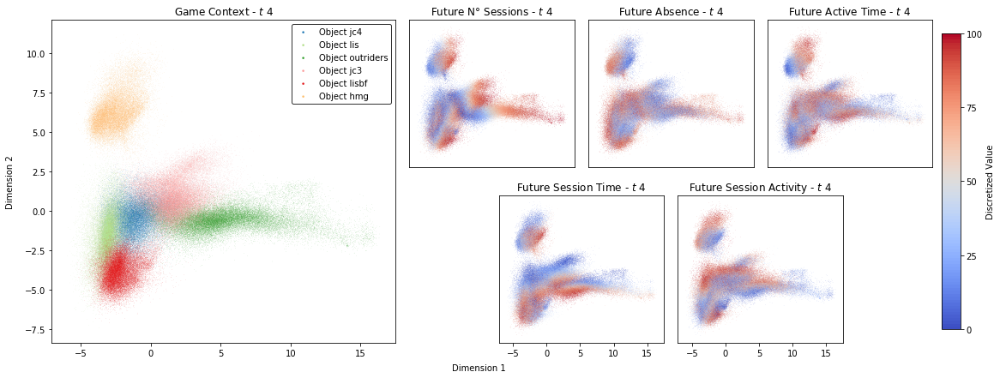

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


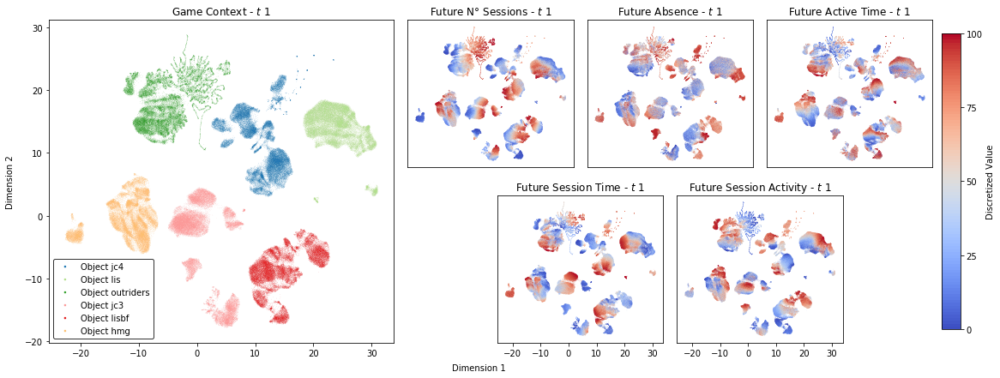

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


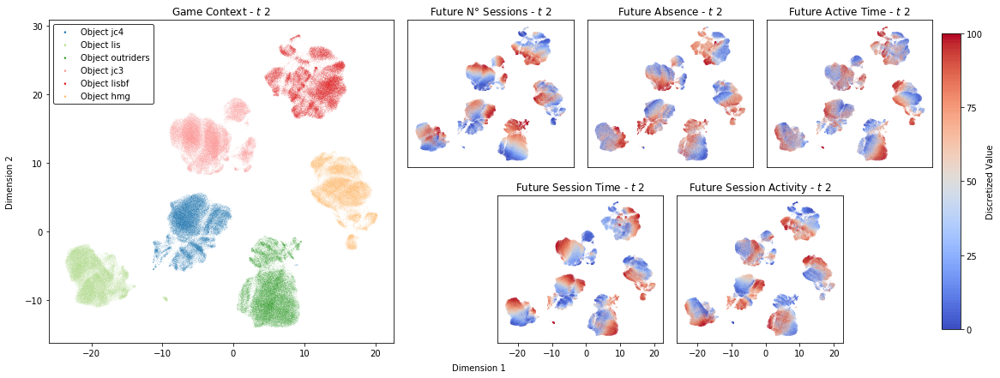

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


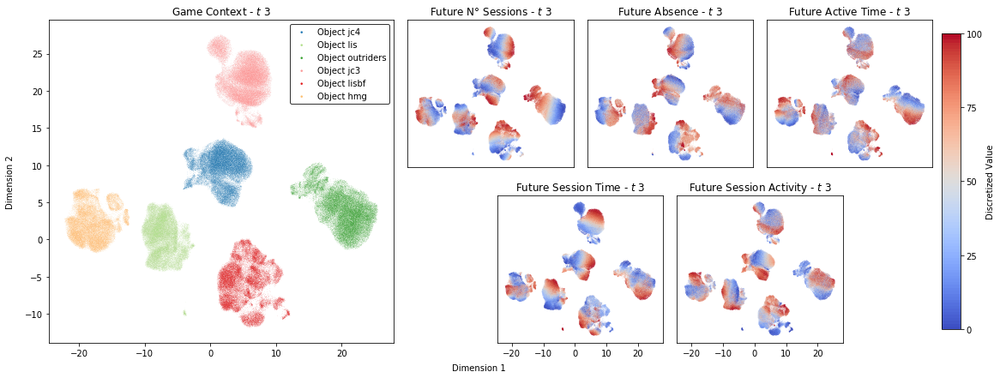

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:132: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


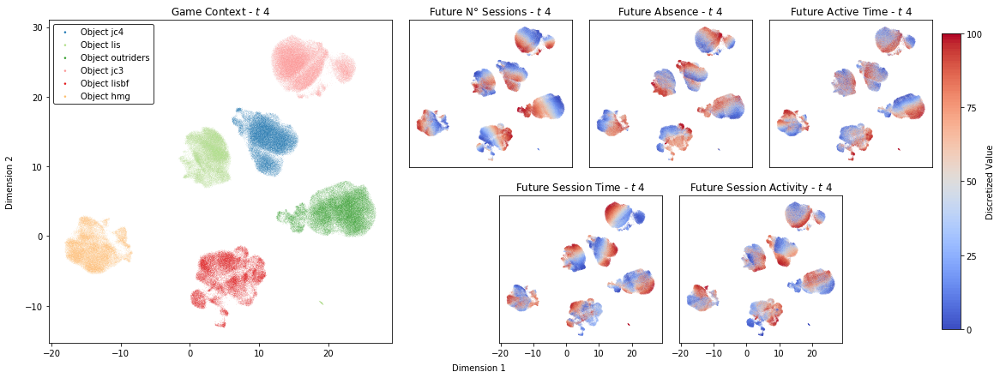

In [10]:
for reduction_type in ['pca', 'umap']:
    
    for snapshot in range(4):

        reduction = np.load(f'results\\saved_dim_reduction\\RNN_env_even_0_lstm_layer_shared\\2D\\{reduction_type}{snapshot}.npy')
        reduction = reduction[~np.isnan(reduction).any(axis=1)]
        colors_dict = {target_name: None for target_name in TARGETS}

        for color_name, array in colors_dict.items():

            binned_array = group_wise_binning(
                array=container['prediction']['RNN_env_even'][color_name][snapshot],
                grouper=container['context'][snapshot],
                n_bins=100,
                method='discret'
            )
            colors_dict[color_name] = binned_array

        visualize_full_panel(
            reduction=reduction, 
            contexts=container['context'][snapshot],
            context_remap=CONTEXT_RMP,
            colors_dict=colors_dict, 
            colors_remap=TARGETS_RMP,
            colors_name=TARGETS, 
            cmapper=CMAP,
            snapshot=snapshot+1,
            save_name=f'full_umap_state_{snapshot}',
            s=0.1
        )

# ---------------------------------------- PCA -----------------------------------------------------

# BASIC MODEL

### BEHAVIOURAL REPRESENTATION / PLAYER STATE

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


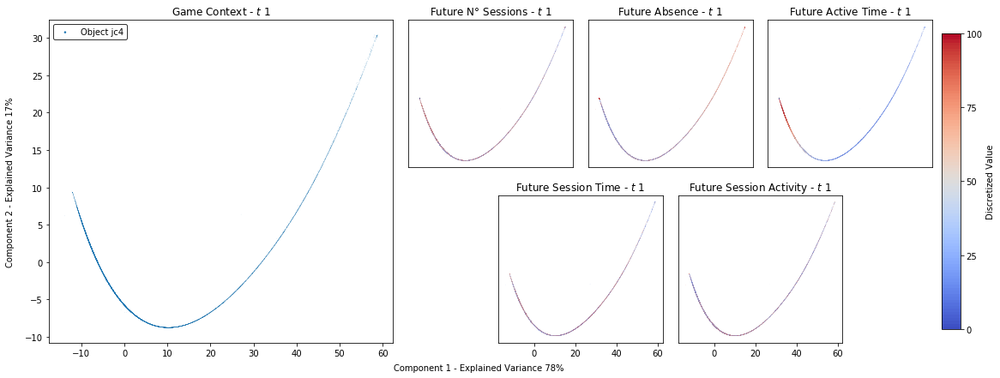

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


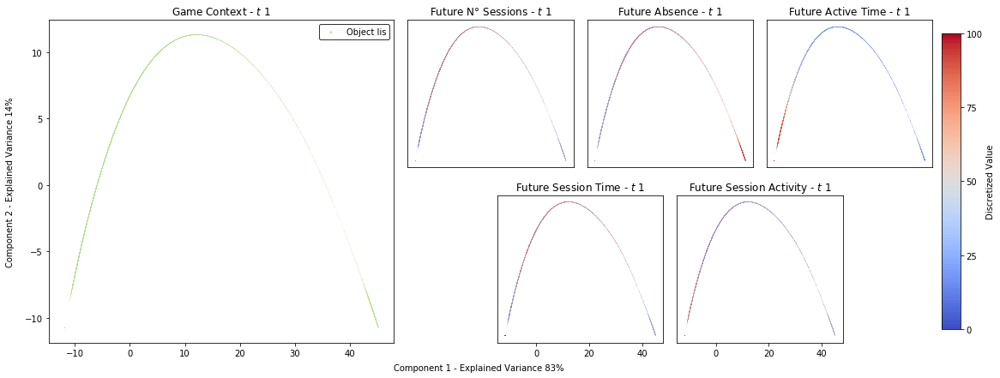

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


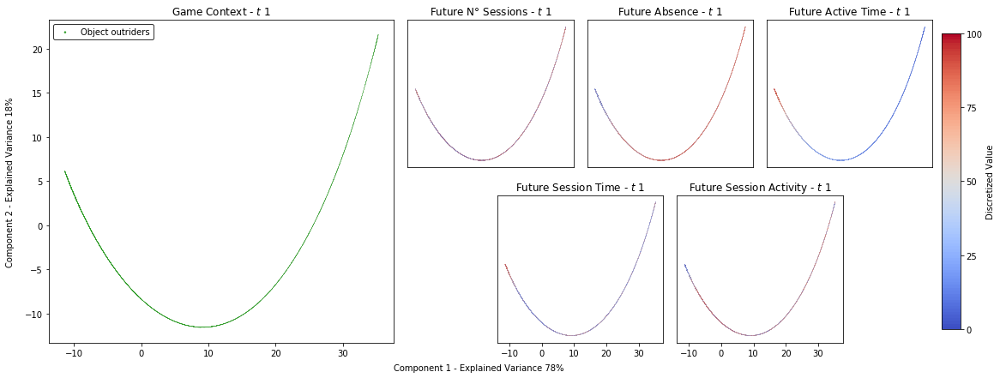

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


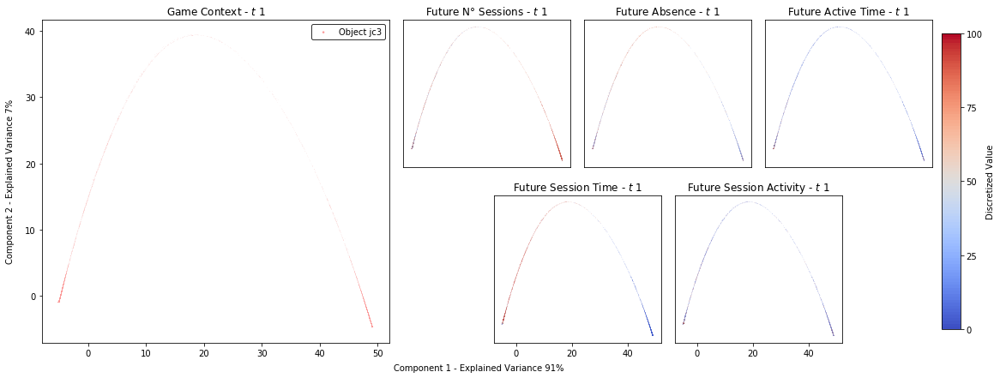

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


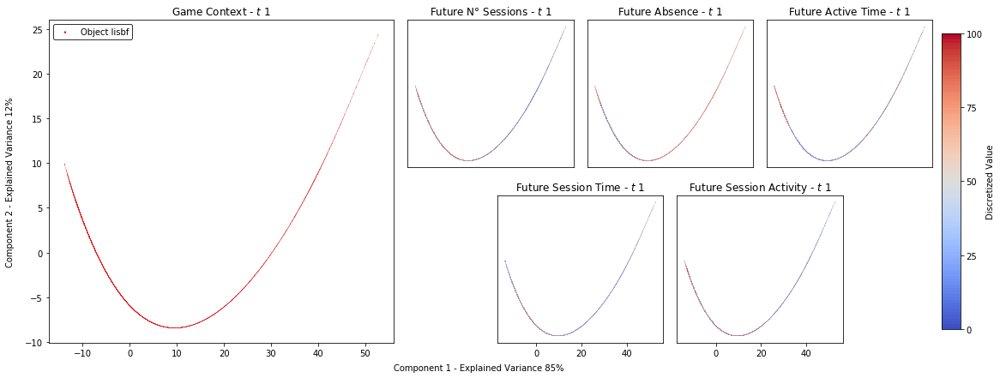

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


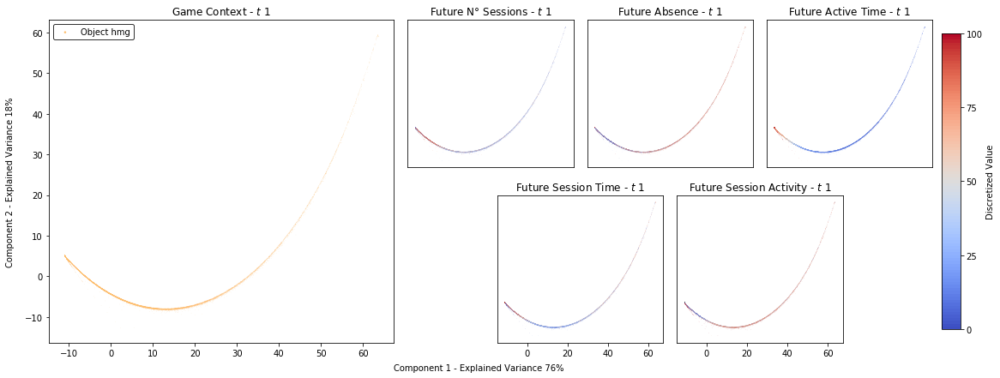

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


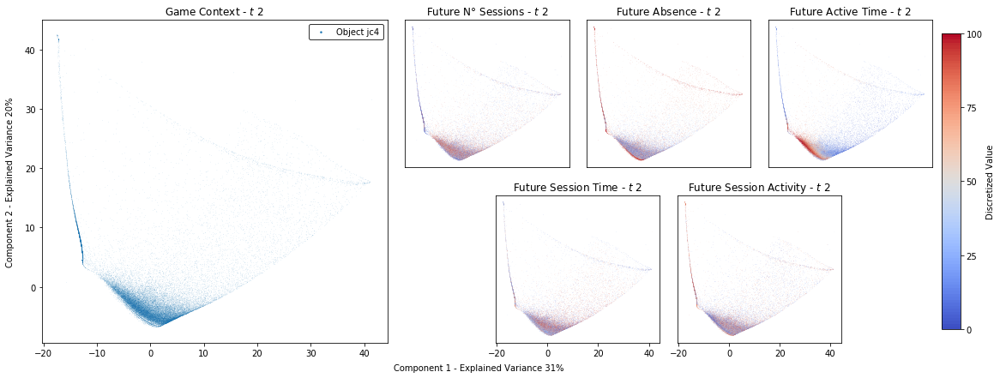

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


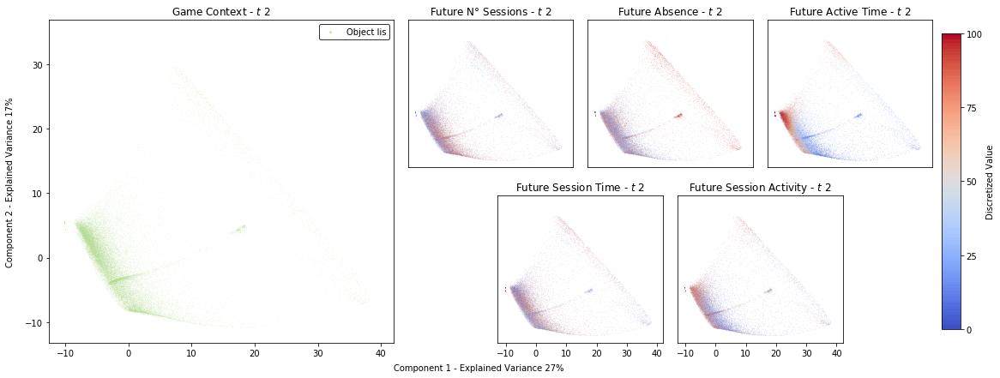

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


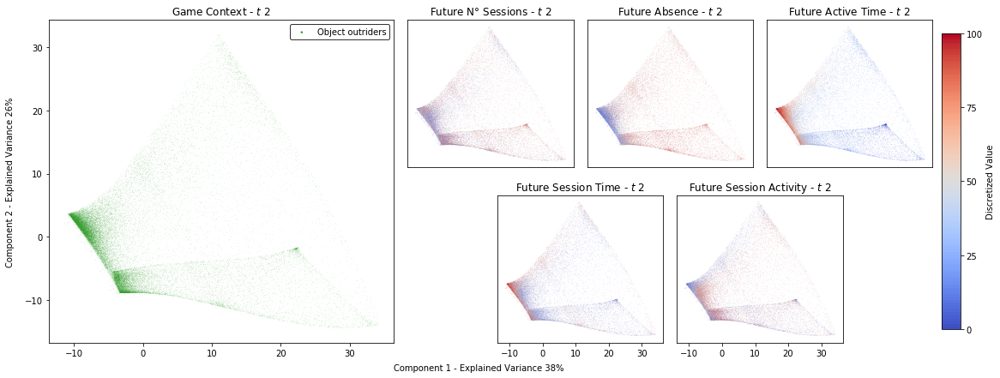

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


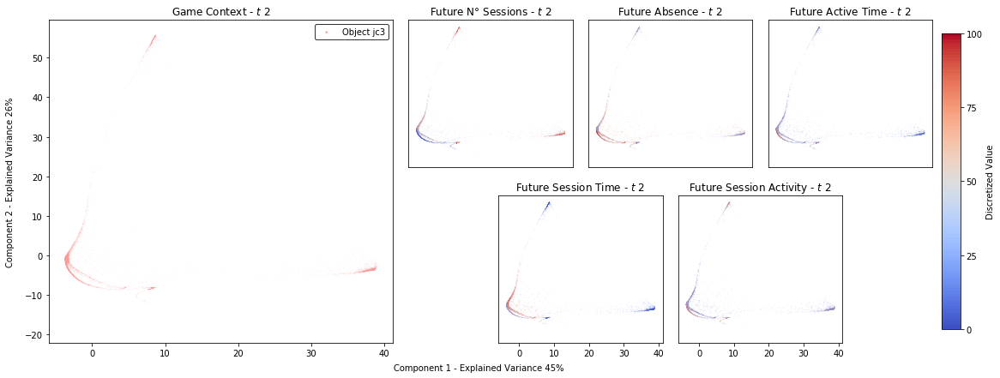

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


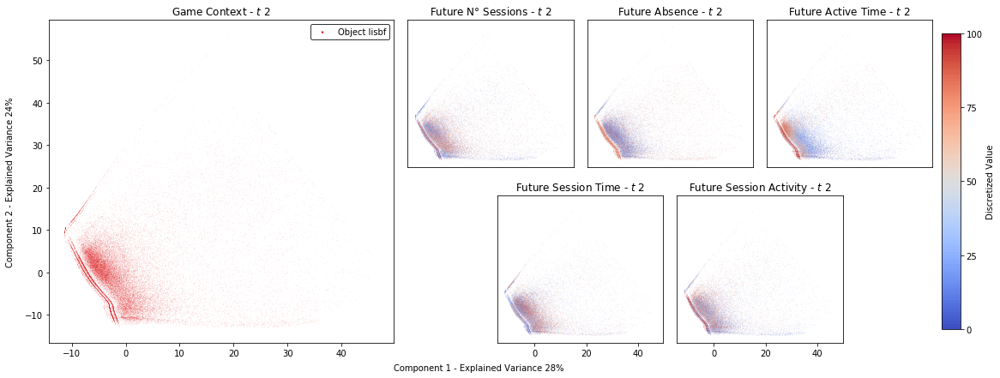

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


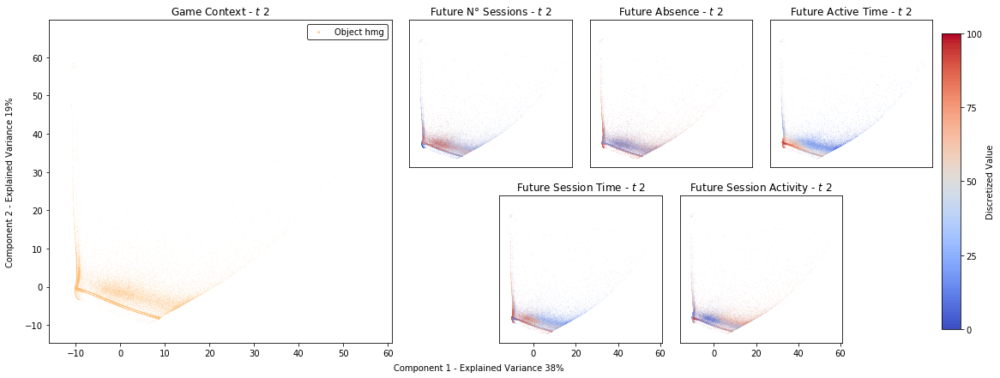

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


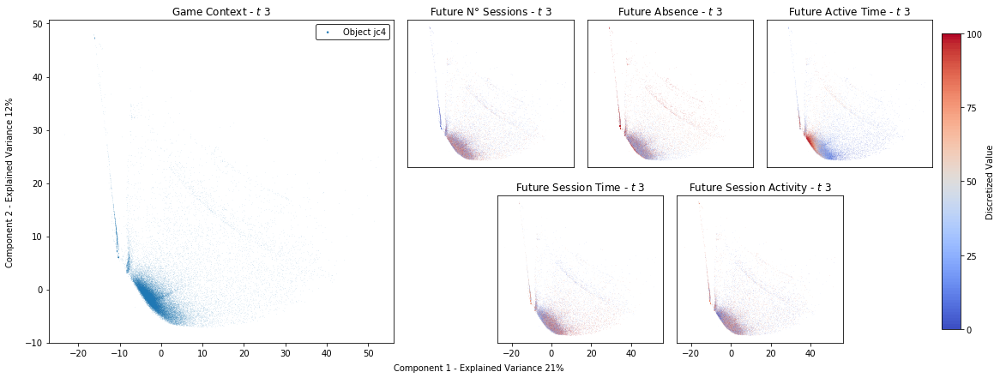

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


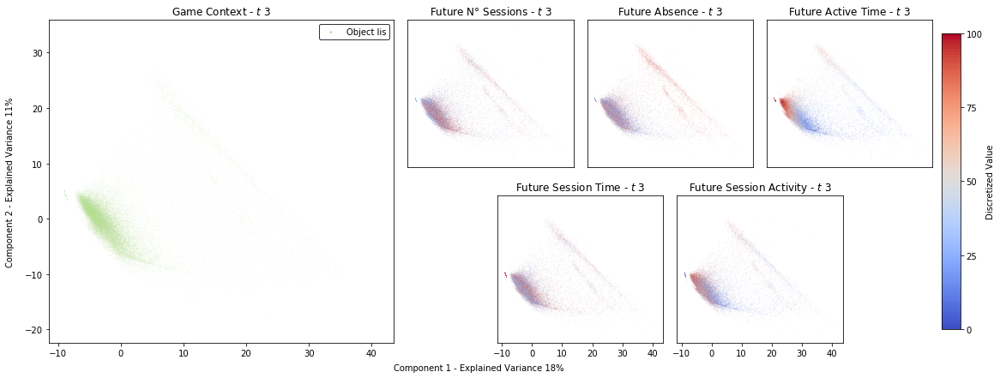

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


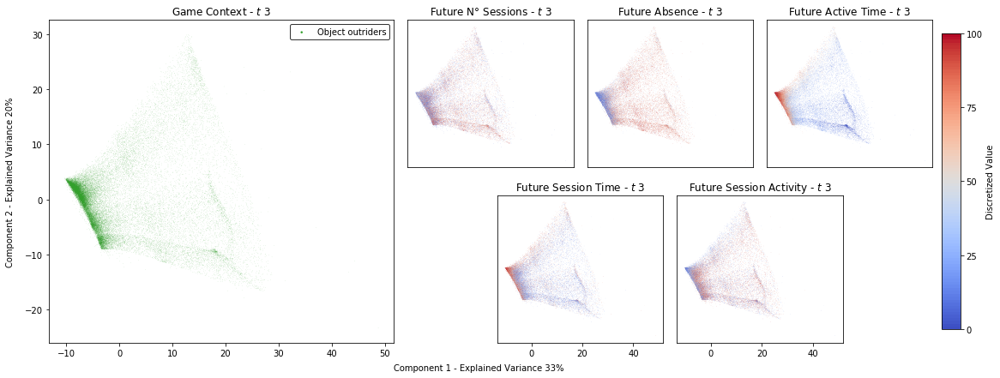

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


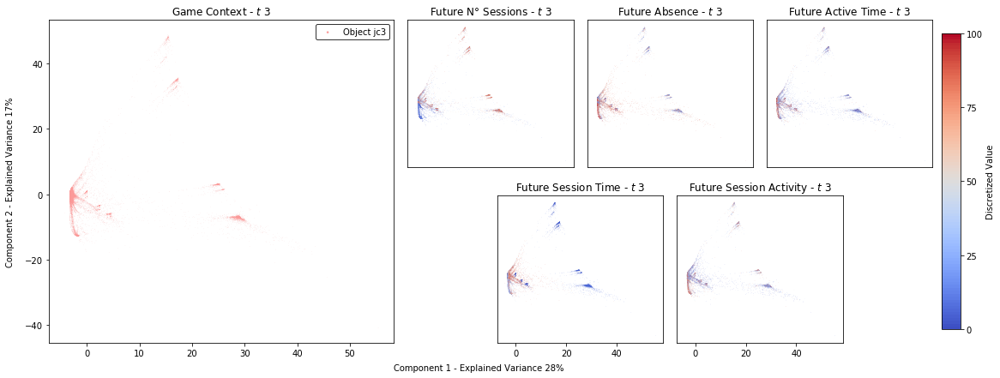

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


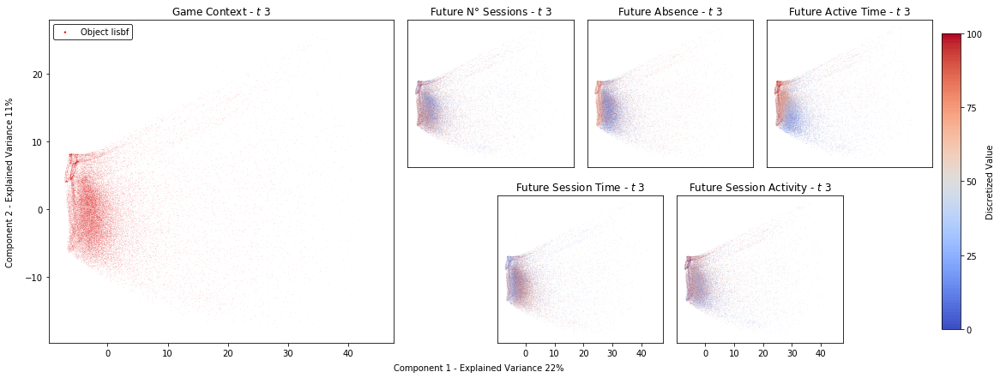

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


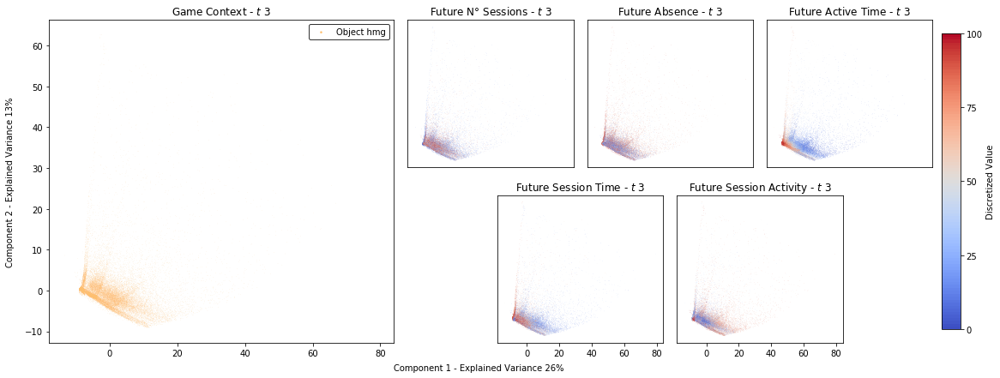

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


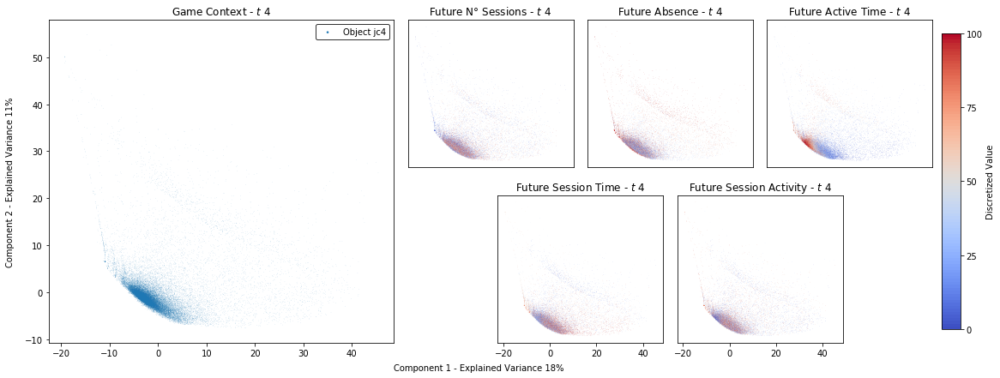

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


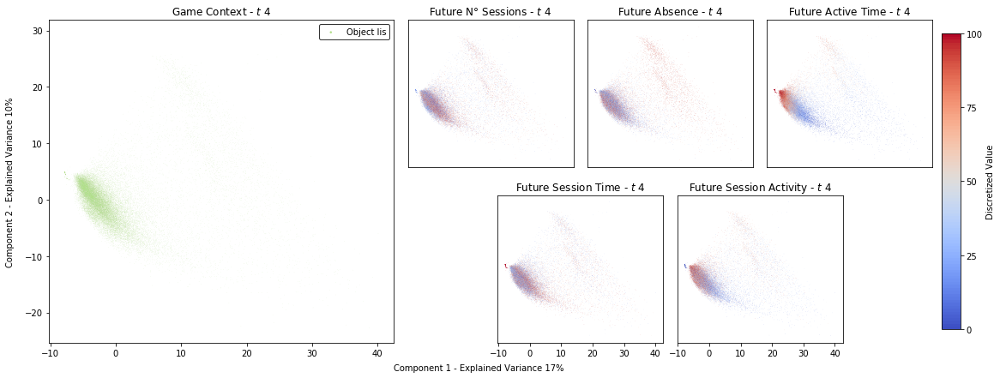

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


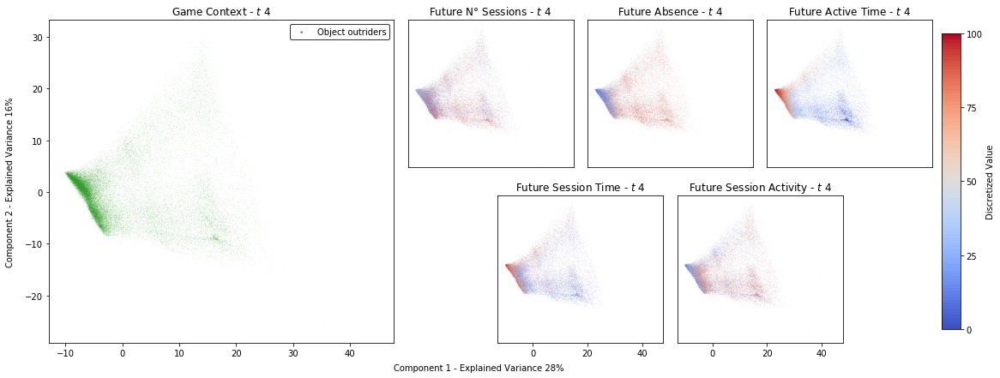

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


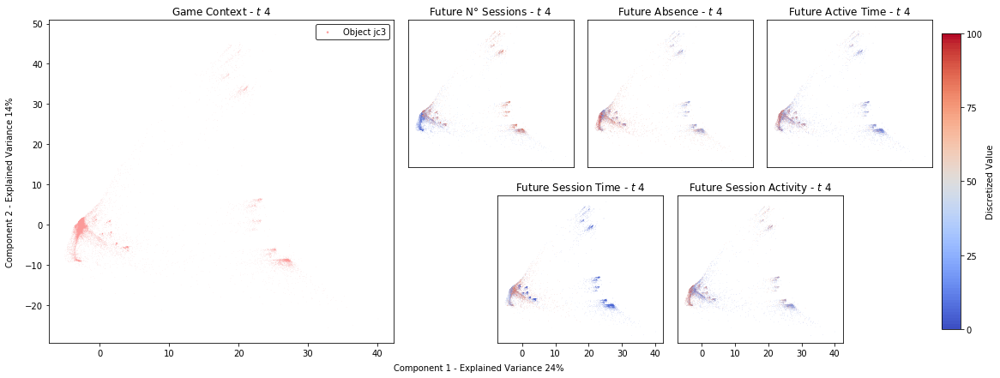

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


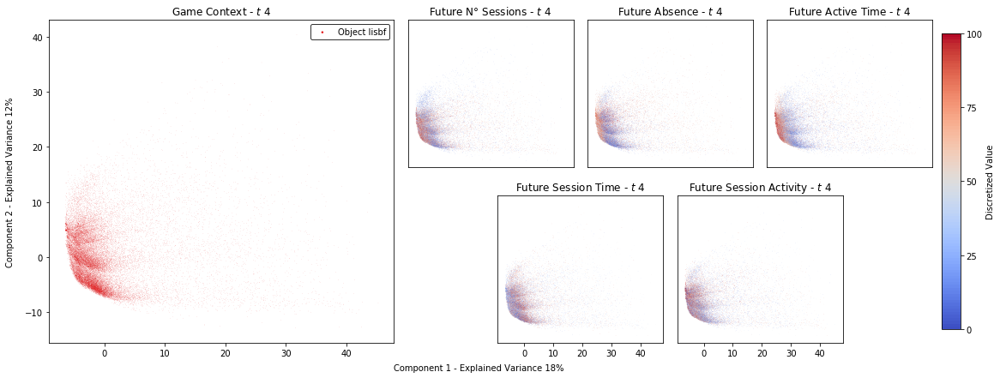

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


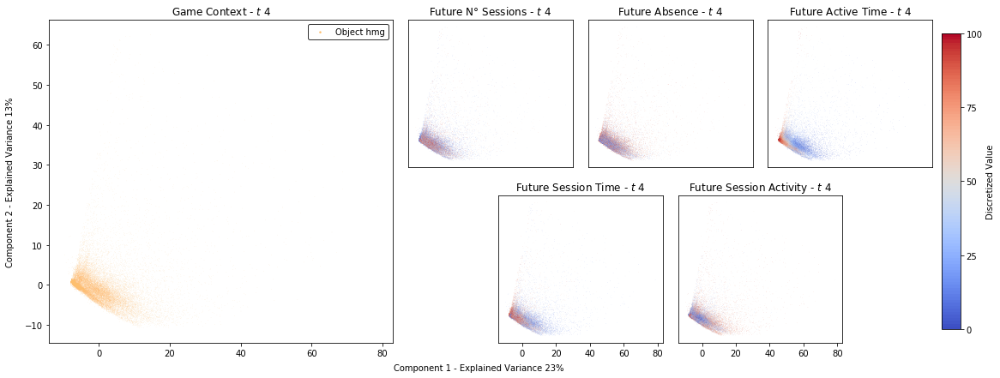

In [27]:
for snapshot in range(4):
    
    embed = np.load(
        f'results\\saved_emb\\RNN_0_lstm_layer_features\\{snapshot}.npy'
    )
    embed = embed[~np.isnan(embed).any(axis=1)]
    contexts = container['context'][snapshot]
    
    for context in np.unique(contexts):
        
        context_idx = np.argwhere(contexts == context).flatten()        
        context_embed = embed[context_idx]
        
        colors_dict = {target_name: None for target_name in TARGETS}

        for color_name, array in colors_dict.items():

            binned_array = group_wise_binning(
                array=container['prediction']['RNN_env_even'][color_name][snapshot][context_idx],
                grouper=container['context'][snapshot][context_idx],
                n_bins=100,
                method='discret'
            )
            colors_dict[color_name] = binned_array
        
        visualize_game_specific_panel(
            embed=context_embed, 
            context=context, 
            context_remap=CONTEXT_RMP,
            colors_dict=colors_dict, 
            colors_remap=TARGETS_RMP,
            colors_name=TARGETS, 
            cmapper=CMAP,
            snapshot=snapshot+1,
            figsize=(15, 6),
            save_name=f'{CONTEXT_RMP[context]}_{snapshot}',
            s=0.1
        )

# FULL MODEL

### BEHAVIOURAL REPRESENTATION

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


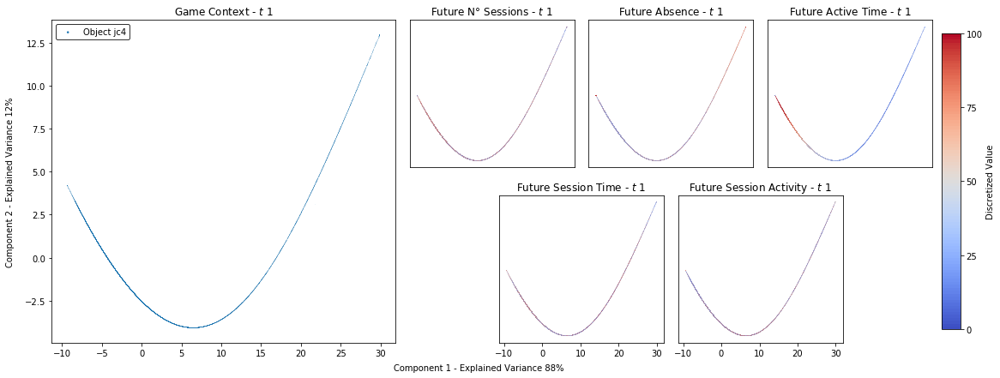

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


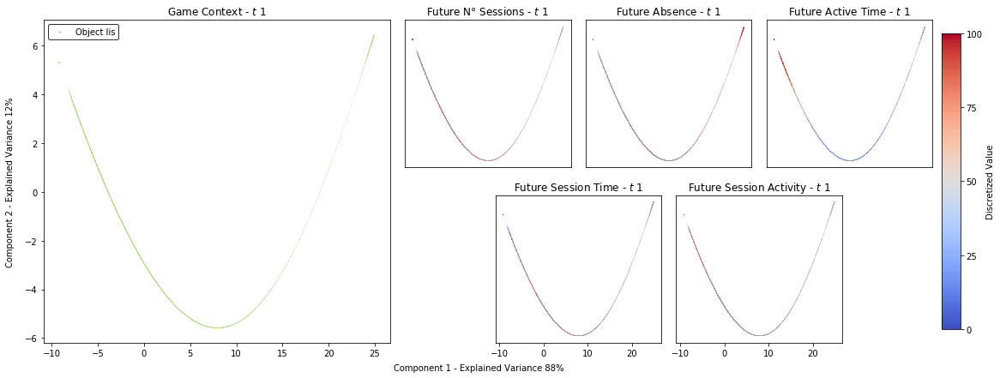

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


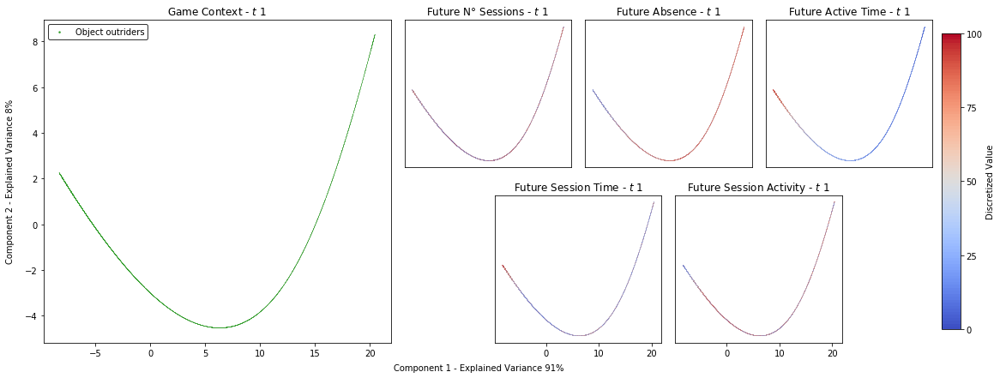

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


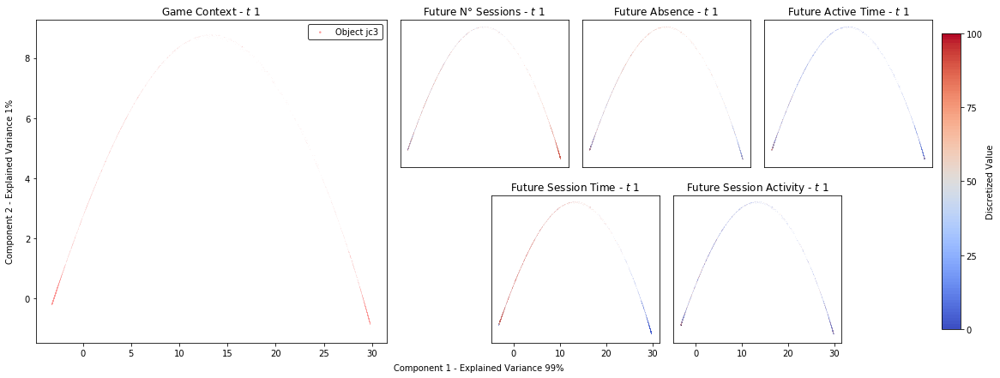

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


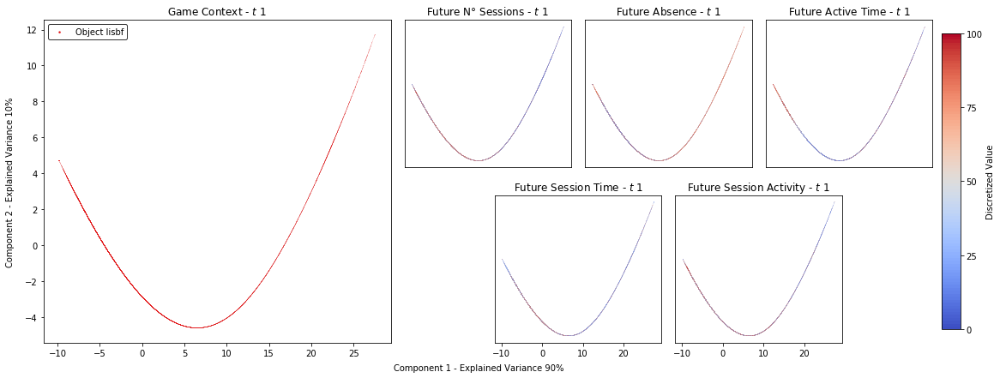

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


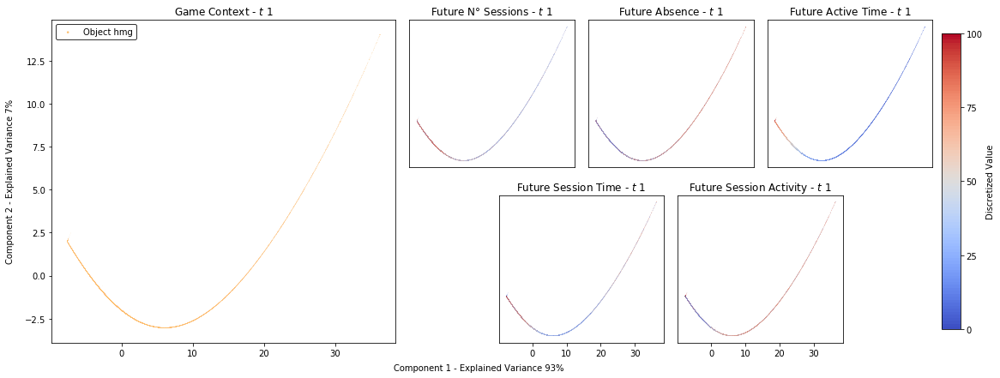

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


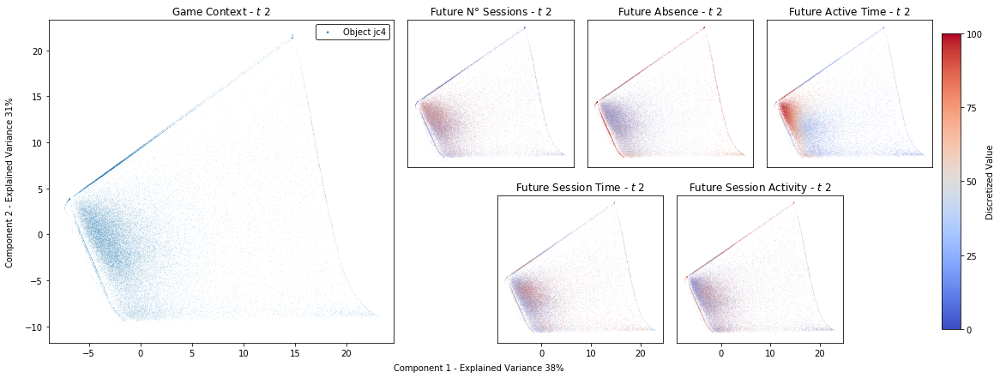

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


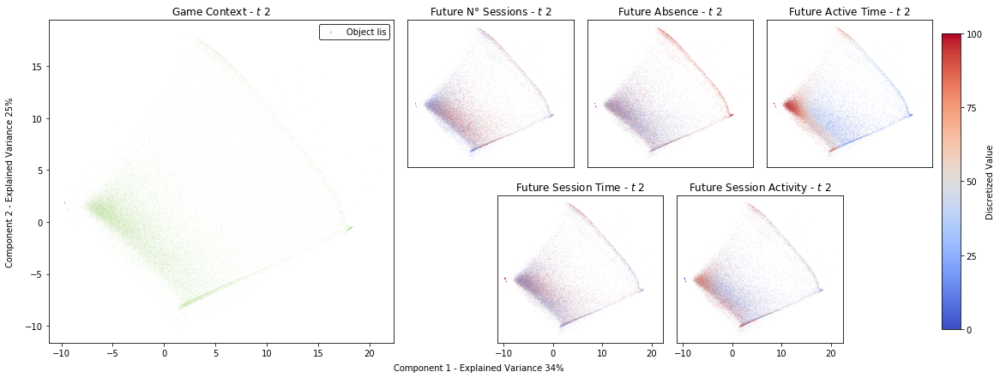

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


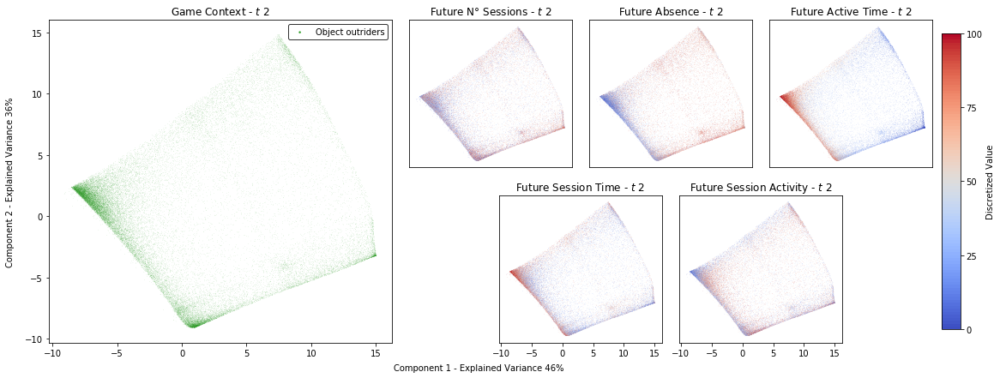

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


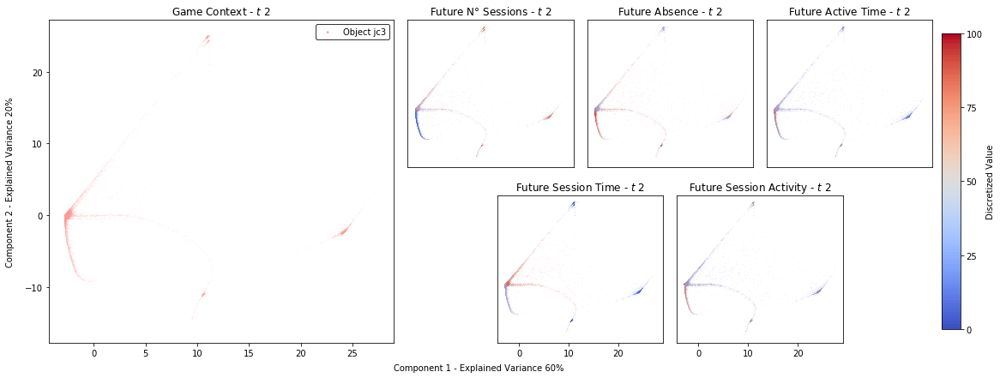

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


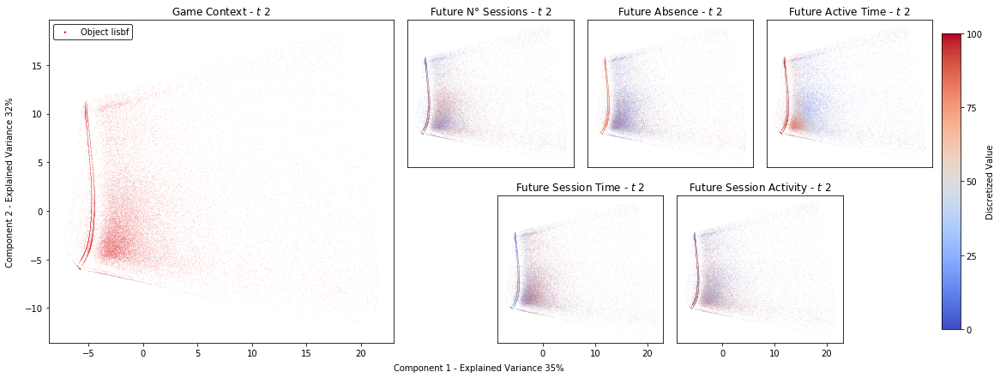

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


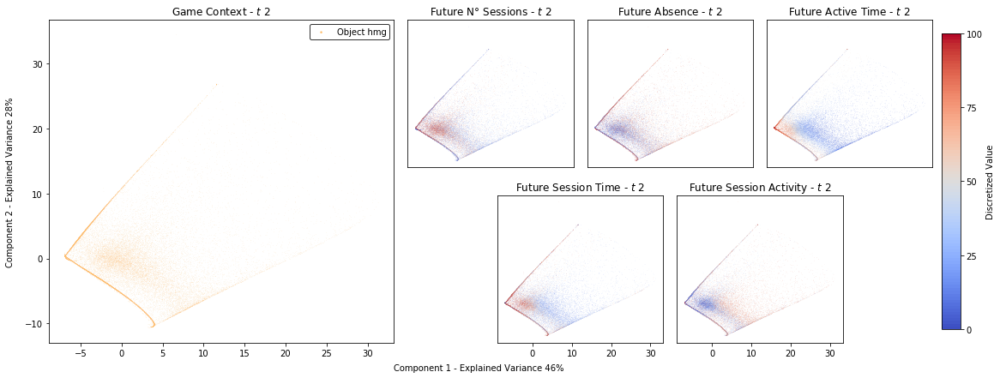

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


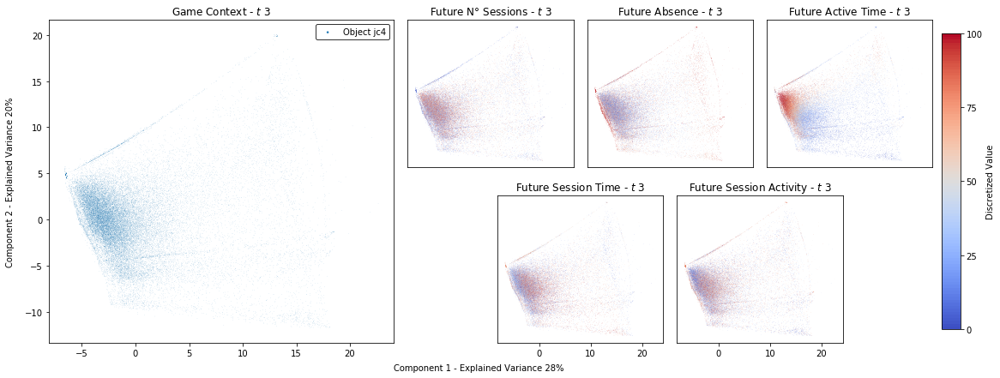

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


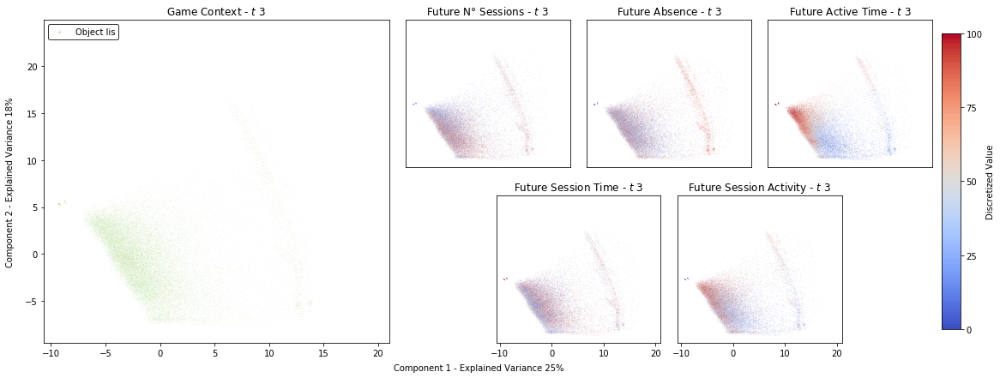

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


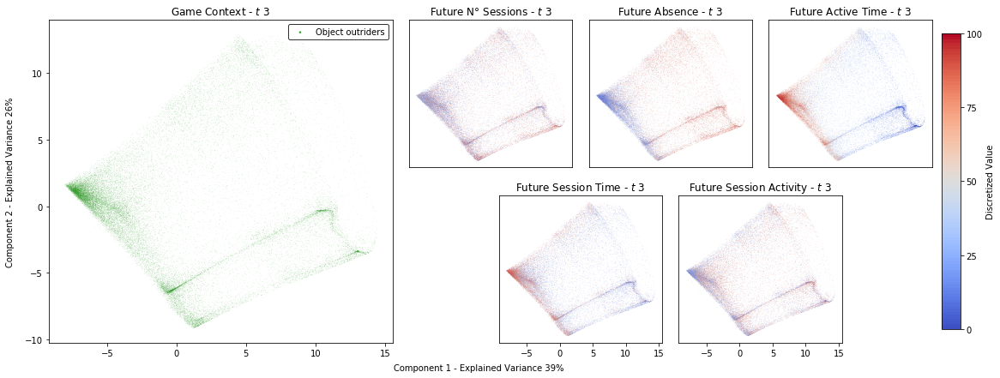

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


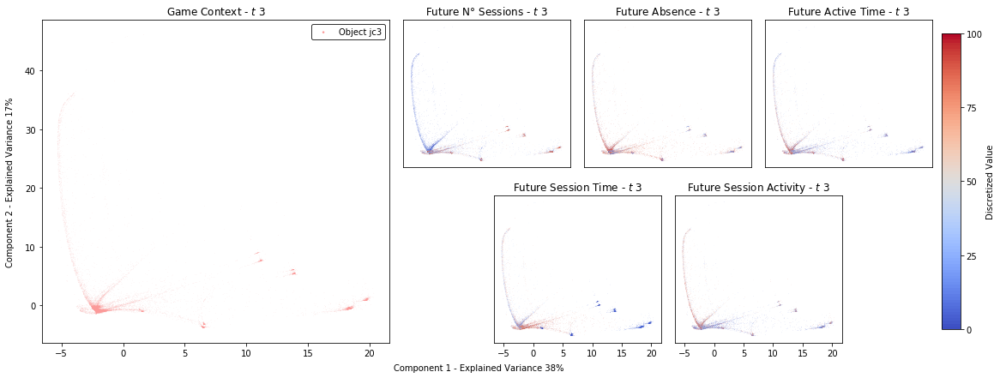

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


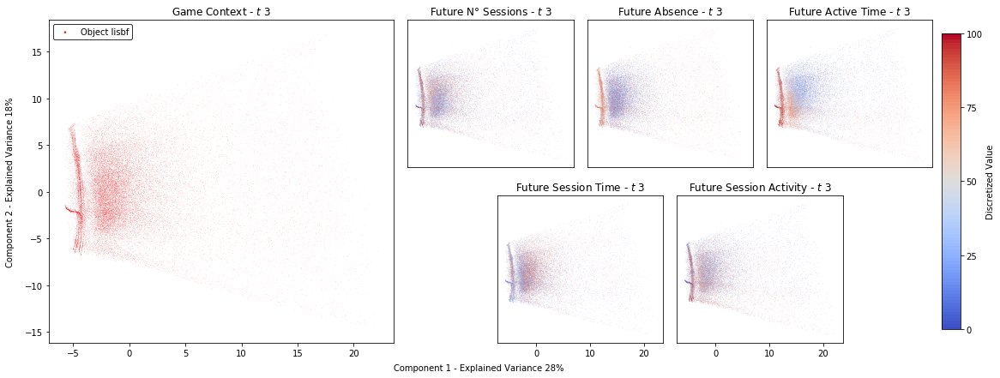

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


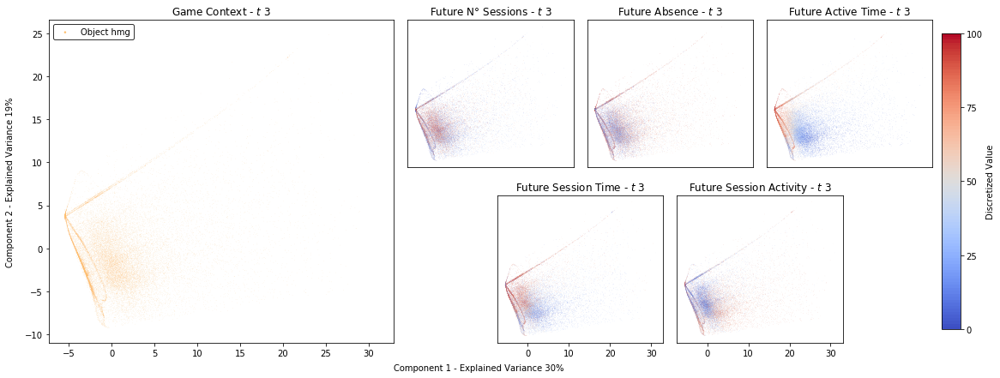

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


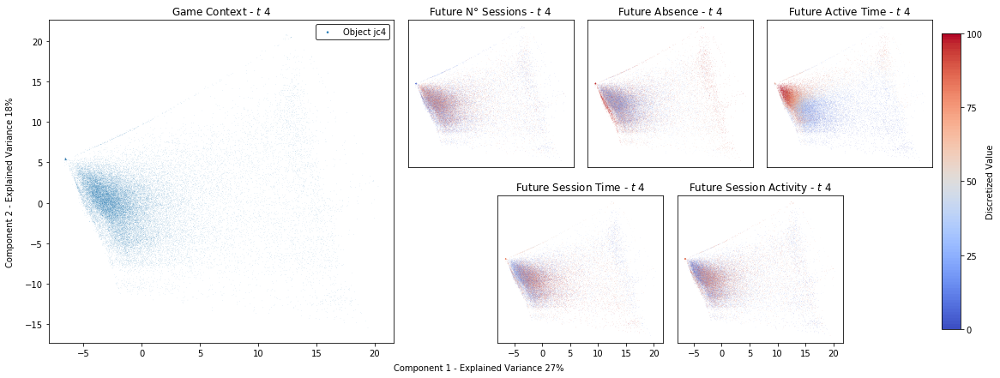

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


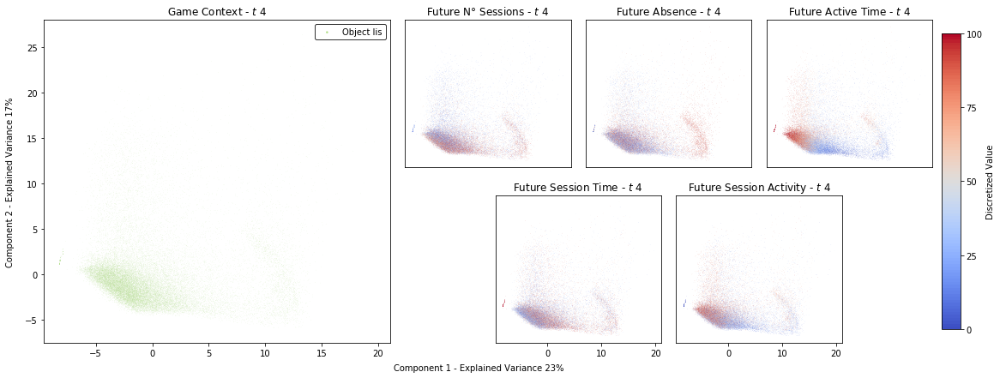

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


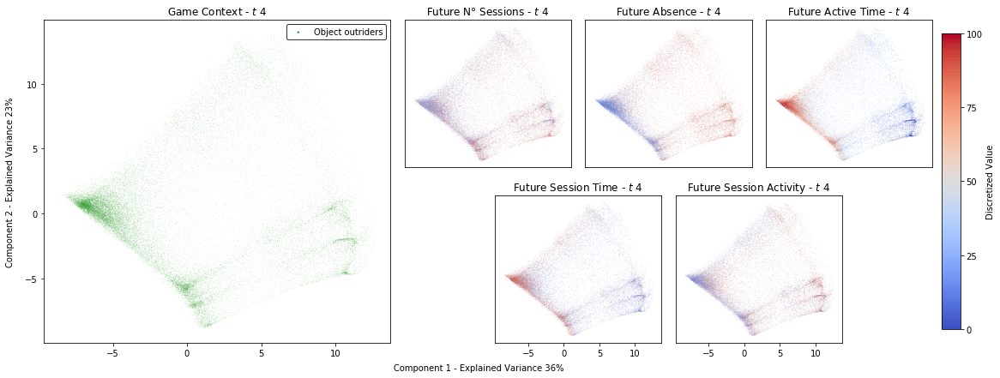

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


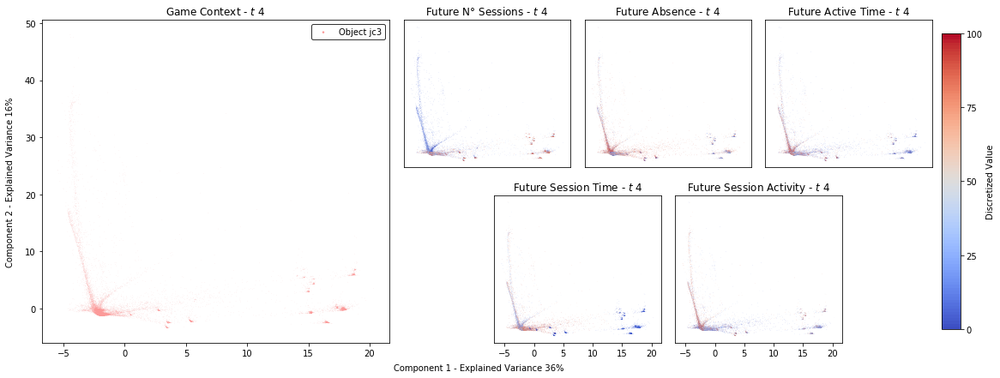

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


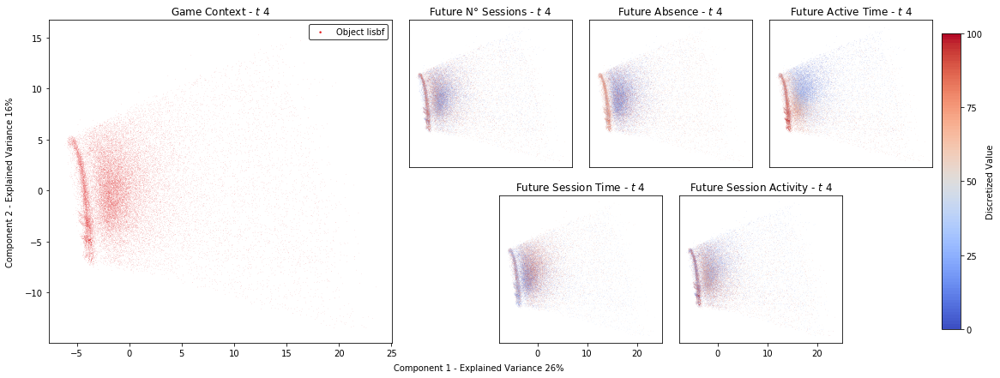

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


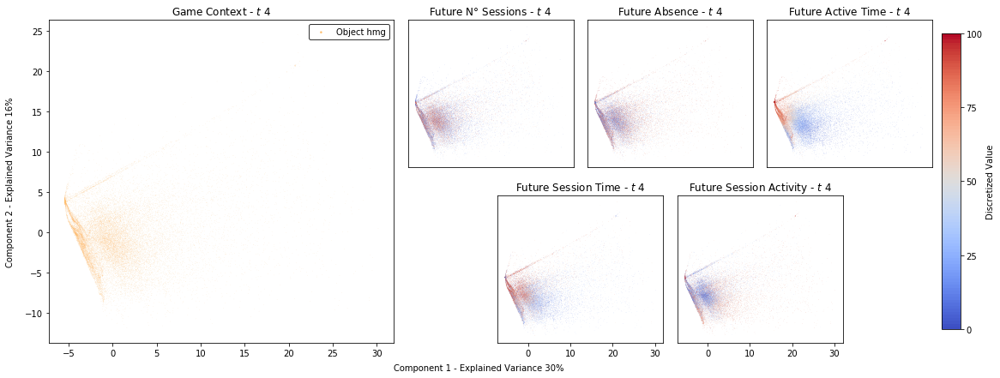

In [28]:
for snapshot in range(4):
    
    embed = np.load(
        f'results\\saved_emb\\RNN_env_even_0_lstm_layer_features\\{snapshot}.npy'
    )
    embed = embed[~np.isnan(embed).any(axis=1)]
    contexts = container['context'][snapshot]
    
    for context in np.unique(contexts):
        
        context_idx = np.argwhere(contexts == context).flatten()        
        context_embed = embed[context_idx]
        
        colors_dict = {target_name: None for target_name in TARGETS}

        for color_name, array in colors_dict.items():

            binned_array = group_wise_binning(
                array=container['prediction']['RNN_env_even'][color_name][snapshot][context_idx],
                grouper=container['context'][snapshot][context_idx],
                n_bins=100,
                method='discret'
            )
            colors_dict[color_name] = binned_array
        
        visualize_game_specific_panel(
            embed=context_embed, 
            context=context, 
            context_remap=CONTEXT_RMP,
            colors_dict=colors_dict, 
            colors_remap=TARGETS_RMP,
            colors_name=TARGETS, 
            cmapper=CMAP,
            snapshot=snapshot+1,
            figsize=(15, 6),
            save_name=f'{CONTEXT_RMP[context]}_{snapshot}',
            s=0.1
        )

### PLAYER STATE REPRESENTATION

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


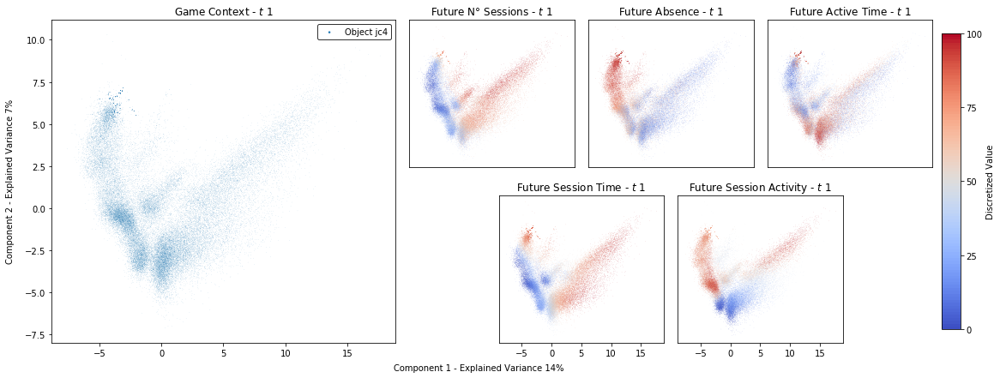

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


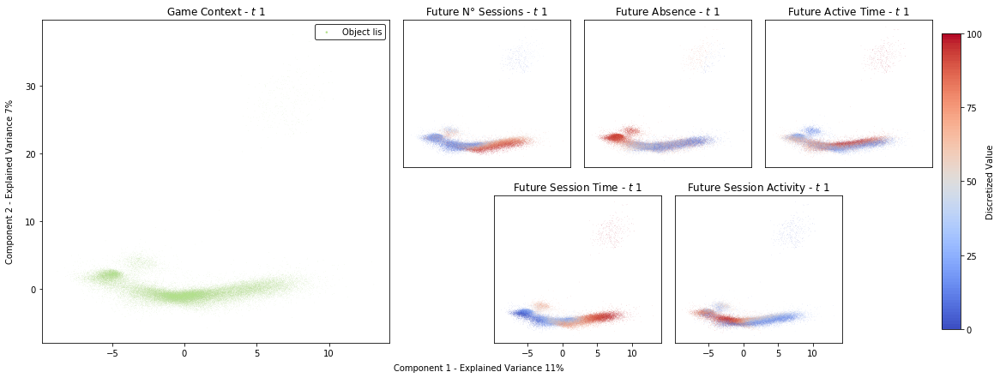

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


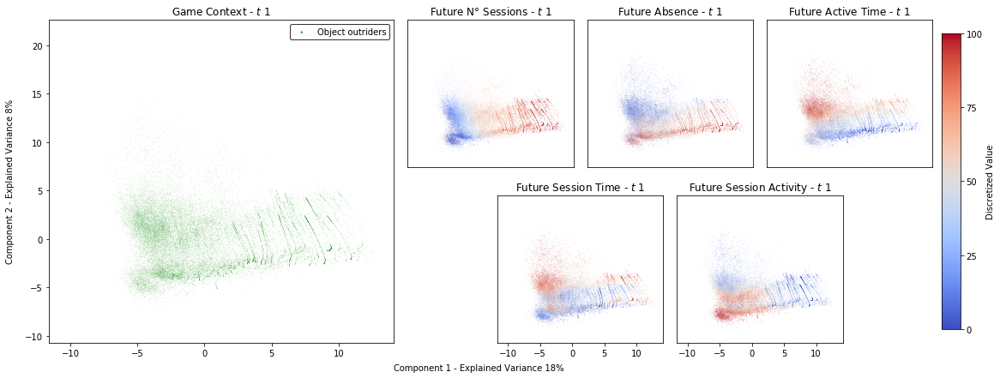

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


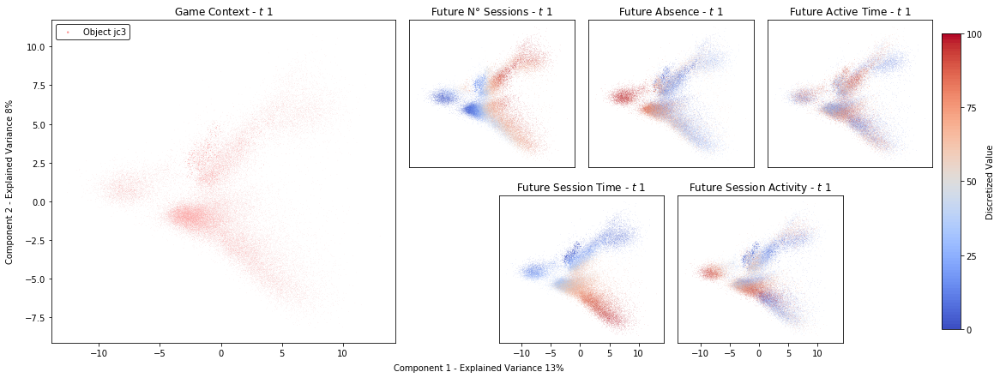

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


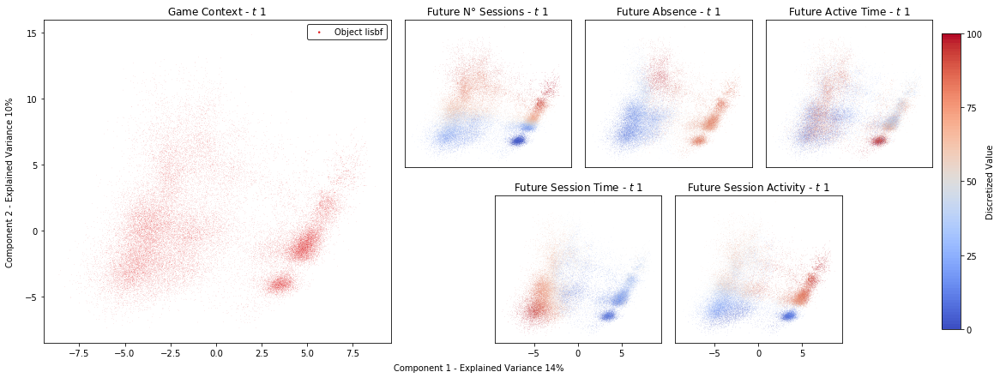

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


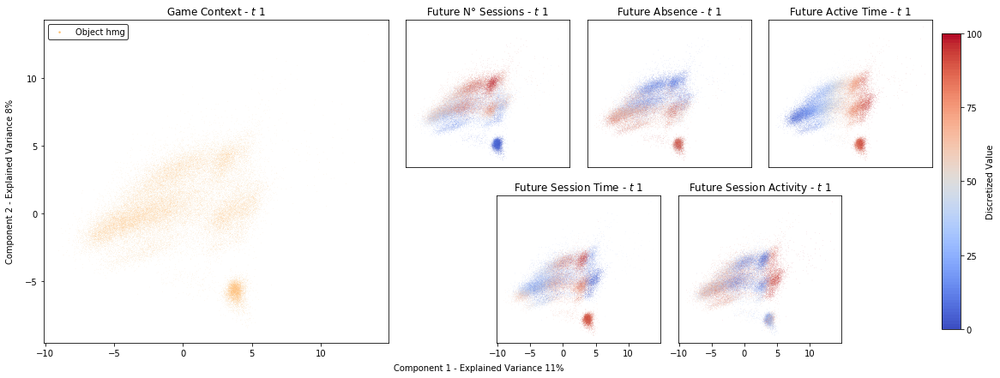

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


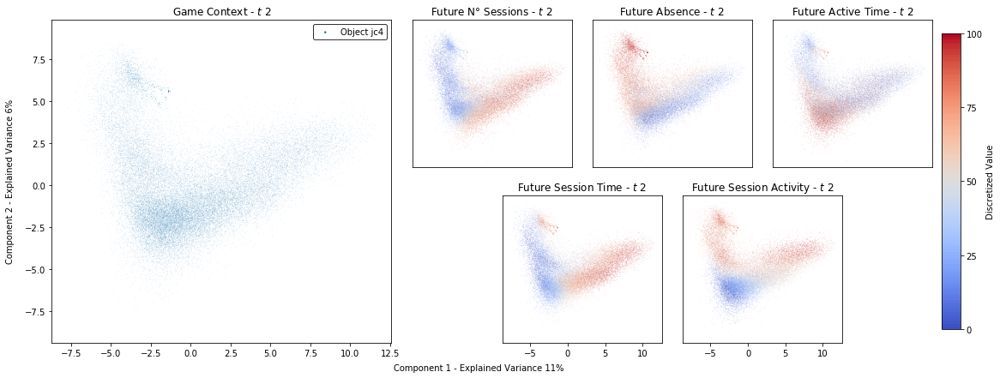

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


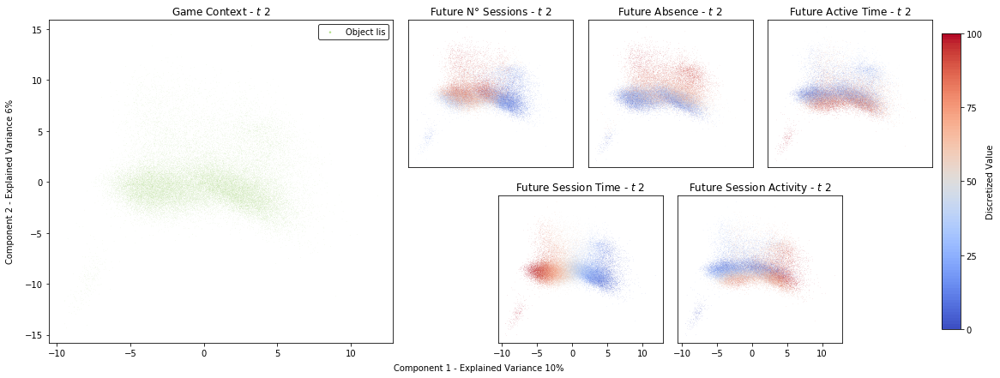

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


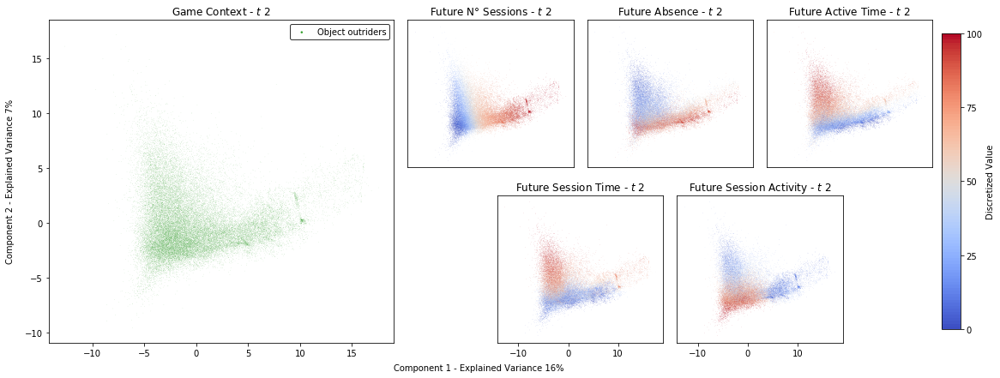

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


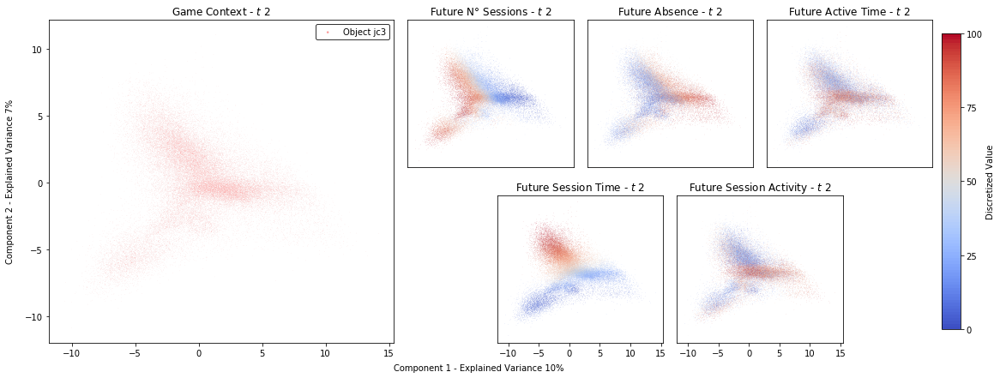

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


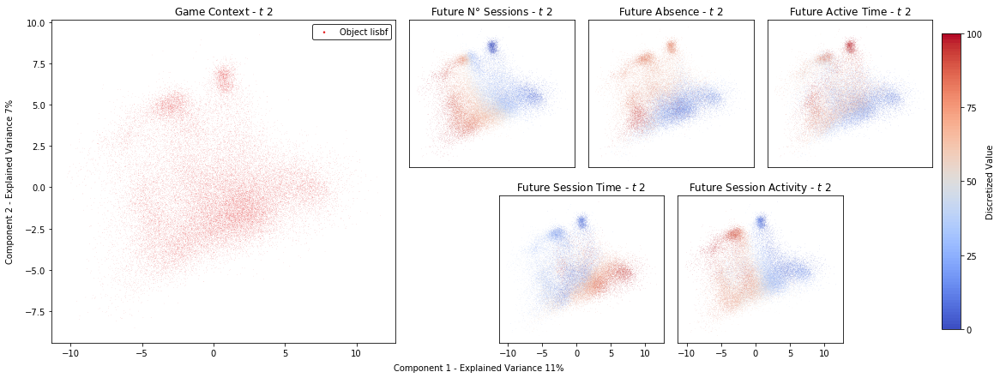

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


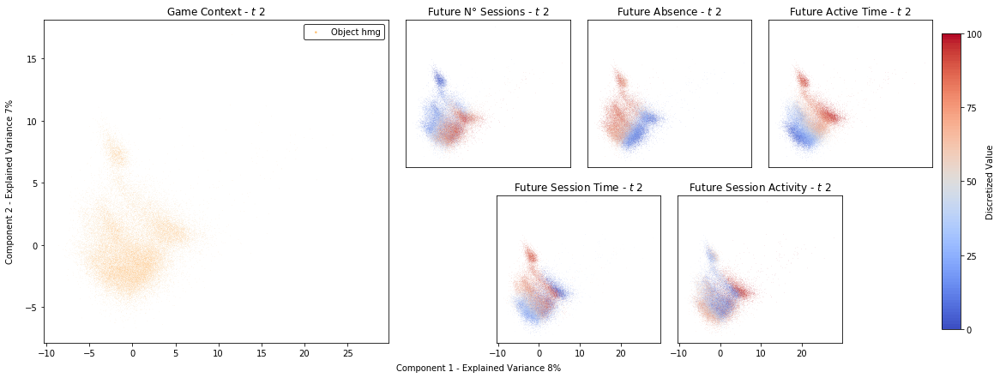

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


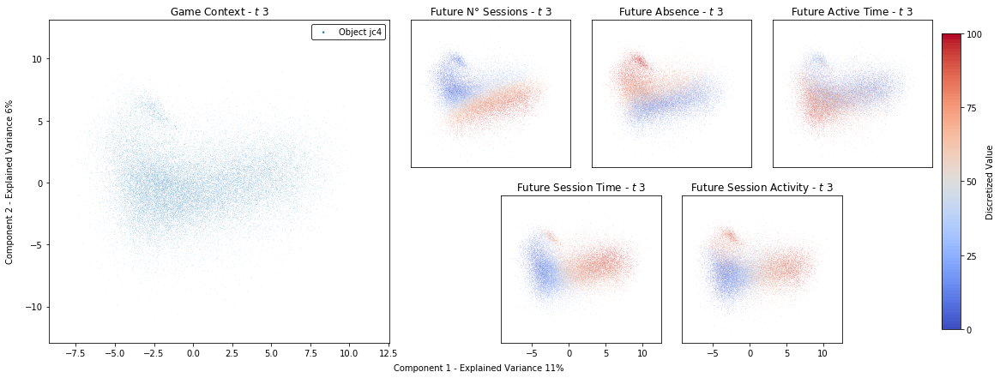

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


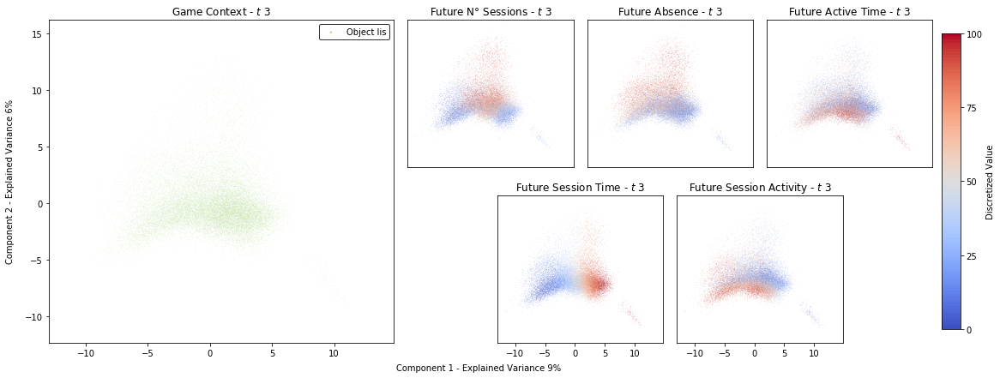

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


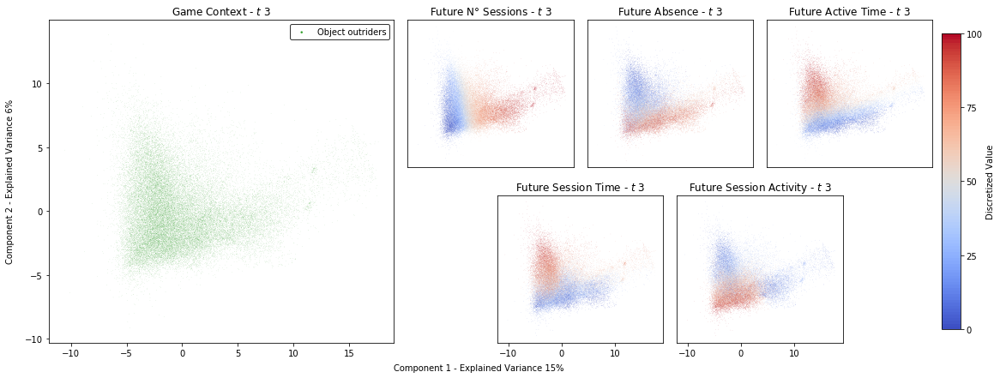

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


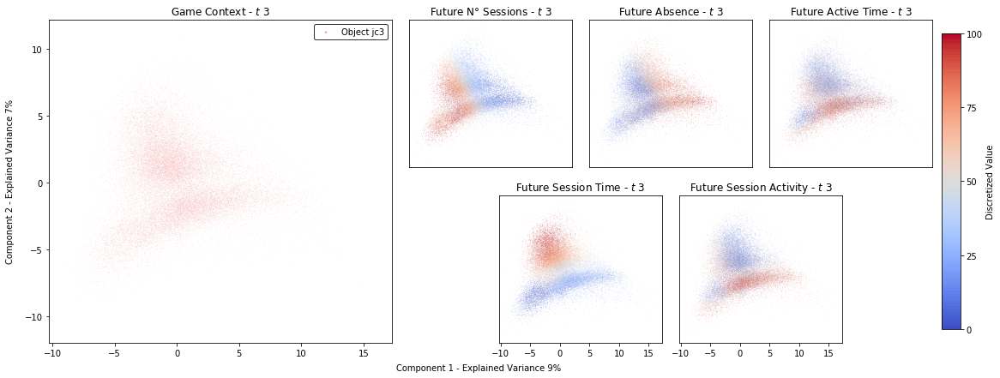

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


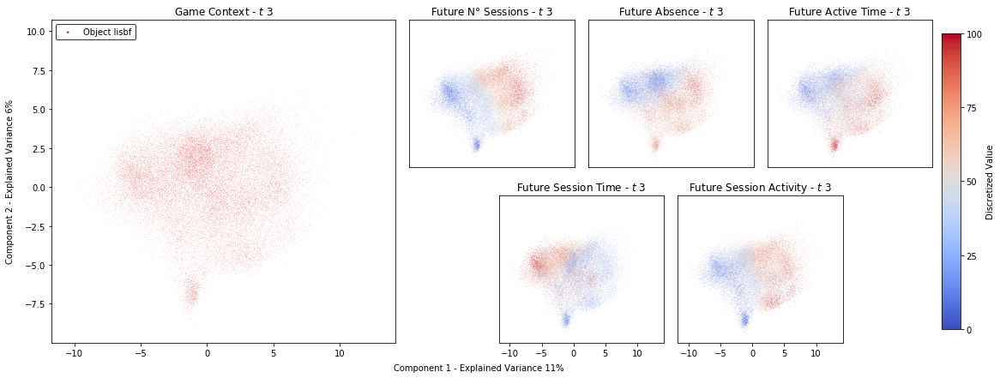

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


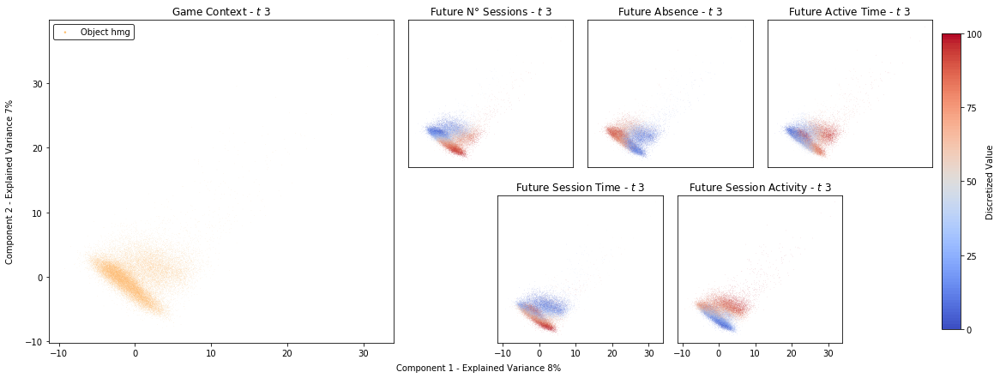

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


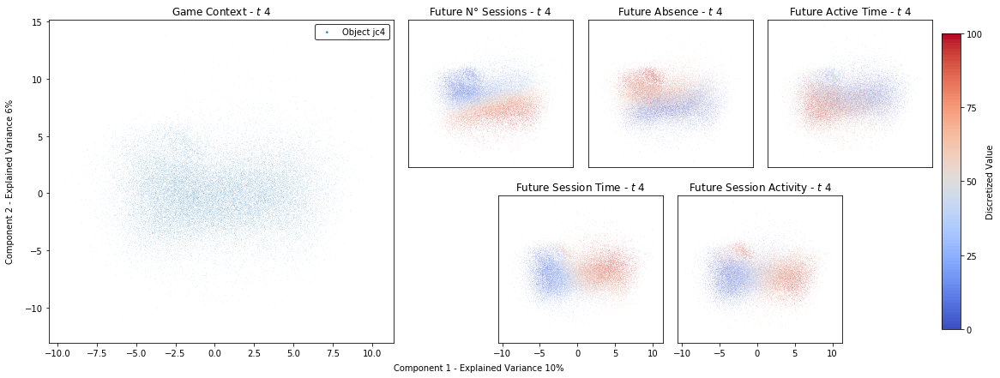

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


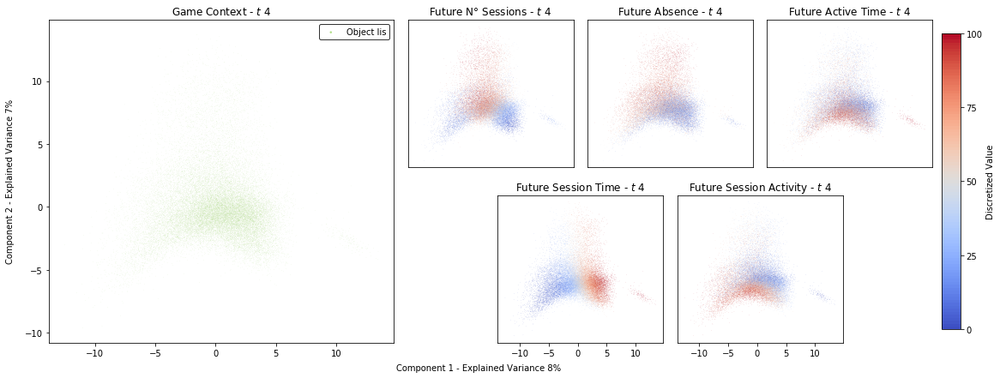

c:\users\penthotal\appdata\local\programs\python\python36\lib\site-packages\sklearn\preprocessing\_discretization.py:222: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  'decreasing the number of bins.' % jj)
C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


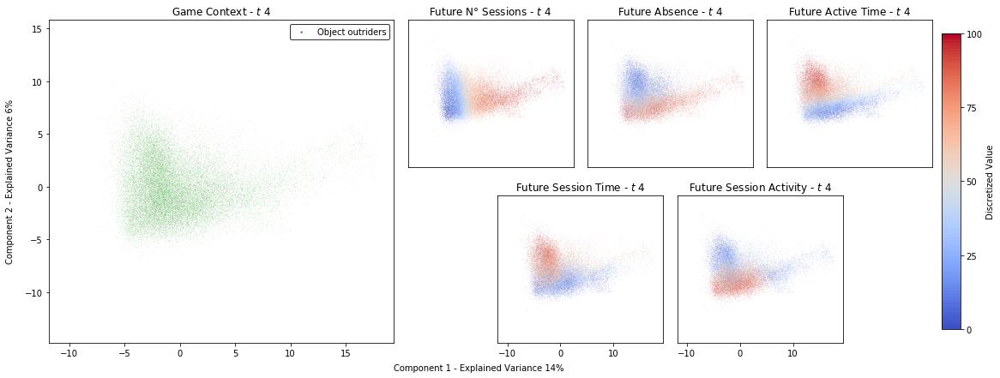

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


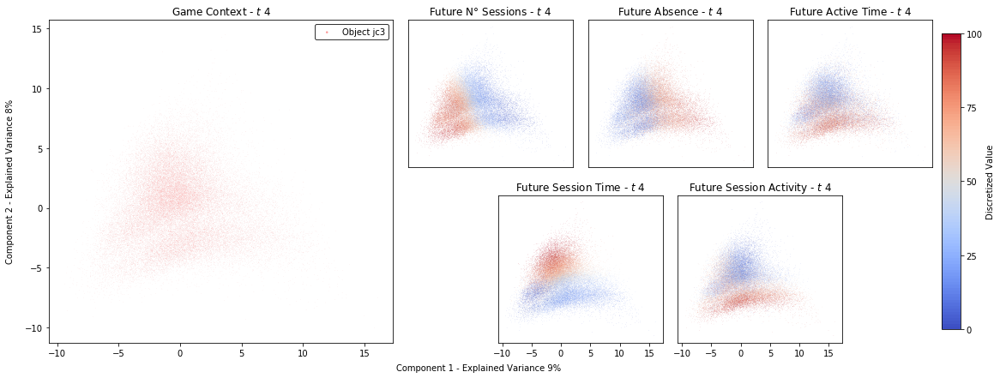

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


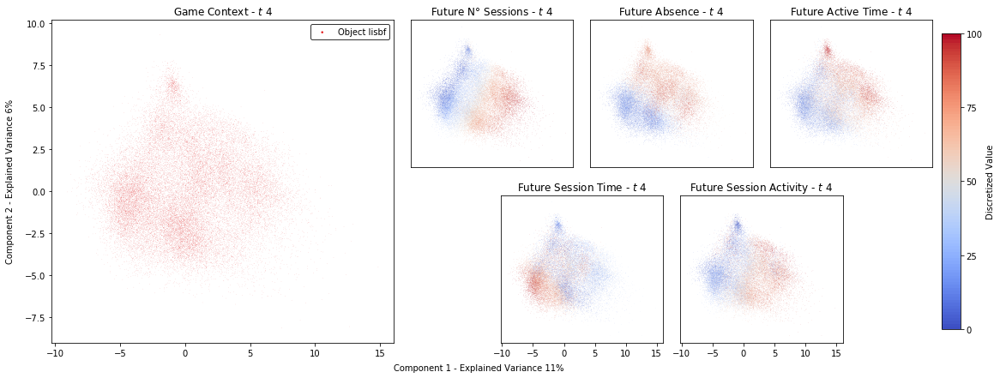

C:\Users\penthotal\Desktop\experiment_3\modules\utils\general_utils\visualizers.py:355: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
  plt.tight_layout()


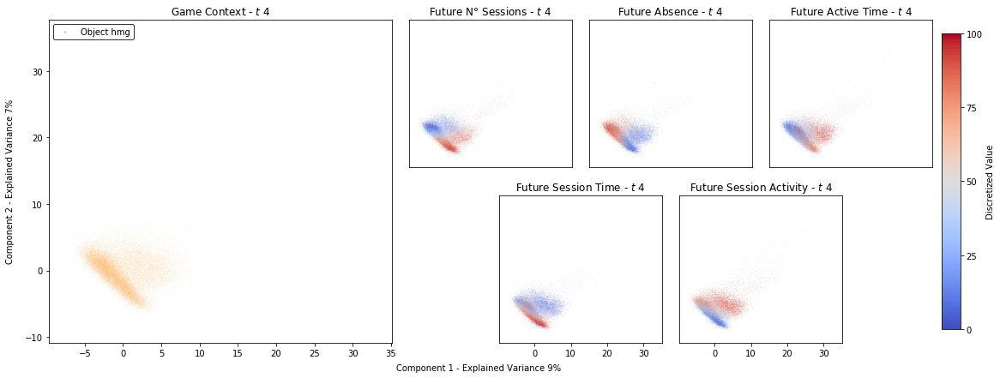

In [29]:
for snapshot in range(4):
    
    embed = np.load(
        f'results\\saved_emb\\RNN_env_even_0_lstm_layer_shared\\{snapshot}.npy'
    )
    embed = embed[~np.isnan(embed).any(axis=1)]
    contexts = container['context'][snapshot]
    
    for context in np.unique(contexts):
        
        context_idx = np.argwhere(contexts == context).flatten()        
        context_embed = embed[context_idx]
        
        colors_dict = {target_name: None for target_name in TARGETS}

        for color_name, array in colors_dict.items():

            binned_array = group_wise_binning(
                array=container['prediction']['RNN_env_even'][color_name][snapshot][context_idx],
                grouper=container['context'][snapshot][context_idx],
                n_bins=100,
                method='discret'
            )
            colors_dict[color_name] = binned_array
        
        visualize_game_specific_panel(
            embed=context_embed, 
            context=context, 
            context_remap=CONTEXT_RMP,
            colors_dict=colors_dict, 
            colors_remap=TARGETS_RMP,
            colors_name=TARGETS, 
            cmapper=CMAP,
            snapshot=snapshot+1,
            figsize=(15, 6),
            save_name=f'{CONTEXT_RMP[context]}_{snapshot}',
            s=0.1
        )

# ---------------------------------------- ERRORS -----------------------------------------------------

## BASIC MODEL

### BEHAVIOURAL REPRESENTATION / PLAYER STATE

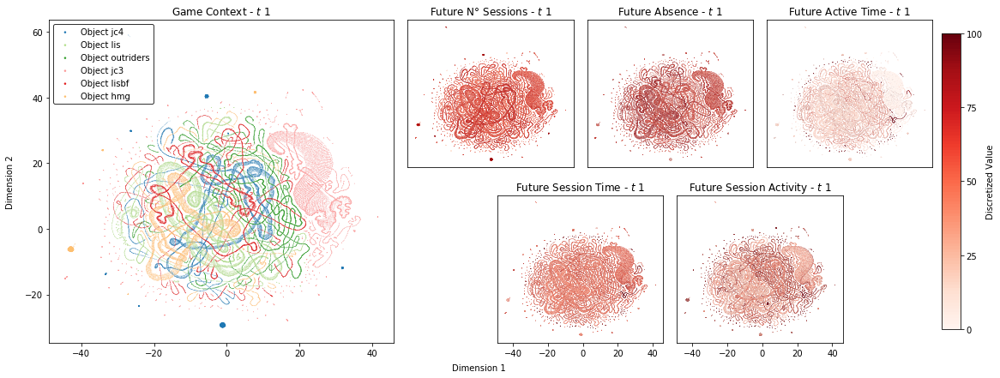

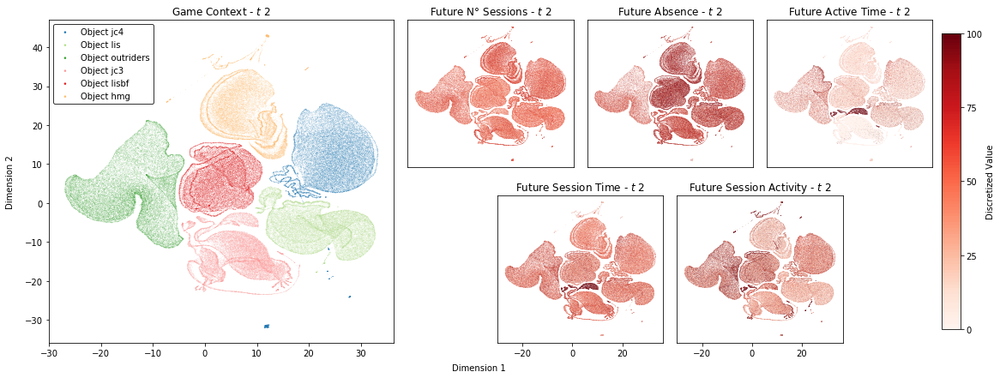

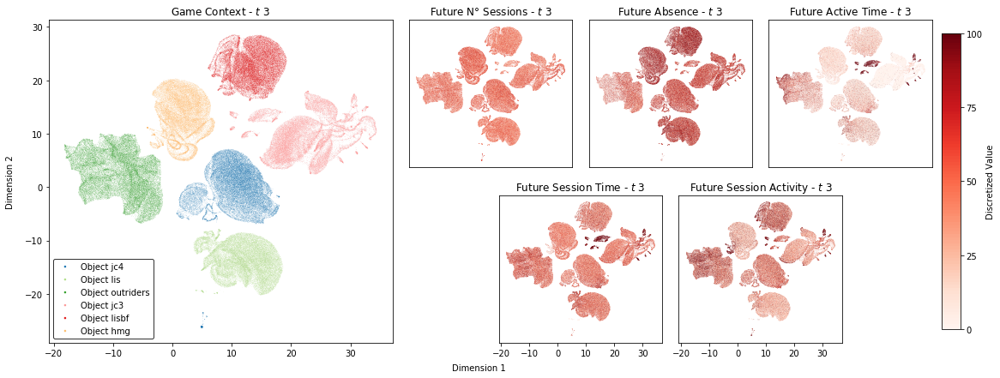

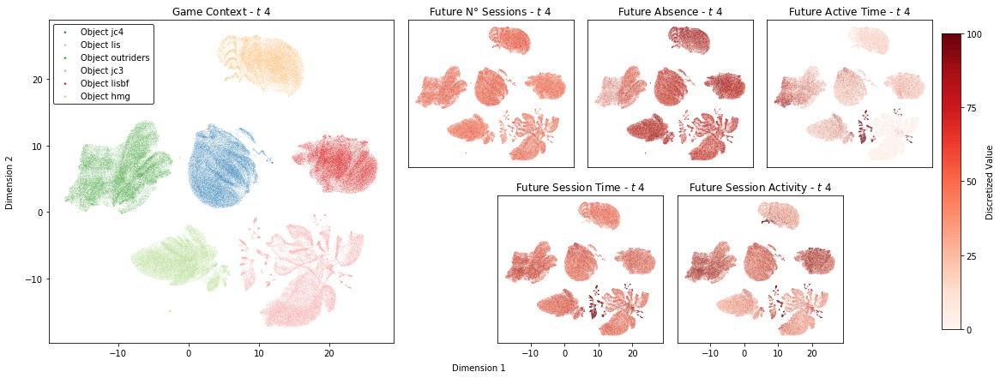

In [10]:
for snapshot in range(4):
    
    reduction = np.load(f'results\\saved_dim_reduction\\RNN_0_lstm_layer_features\\2D\\umap{snapshot}.npy')
    reduction = reduction[~np.isnan(reduction).any(axis=1)]
    colors_dict = {target_name: None for target_name in TARGETS}

    for color_name, array in colors_dict.items():

        colors_dict[color_name] = container['error']['RNN'][color_name][snapshot] * 100
        
    visualize_full_panel(
        reduction=reduction, 
        contexts=container['context'][snapshot],
        context_remap=CONTEXT_RMP,
        colors_dict=colors_dict, 
        colors_remap=TARGETS_RMP,
        colors_name=TARGETS, 
        cmapper=CMAP,
        snapshot=snapshot+1,
        scatter_cmapper='Reds',
        save_name=f'basic_umap_state_error_{snapshot}',
        s=0.1
    )

## FULL MODEL

### BEHAVIOURAL REPRESENTATION

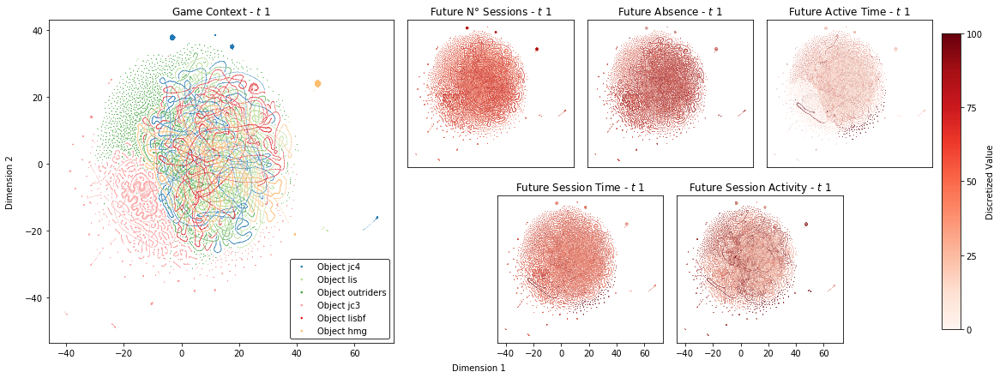

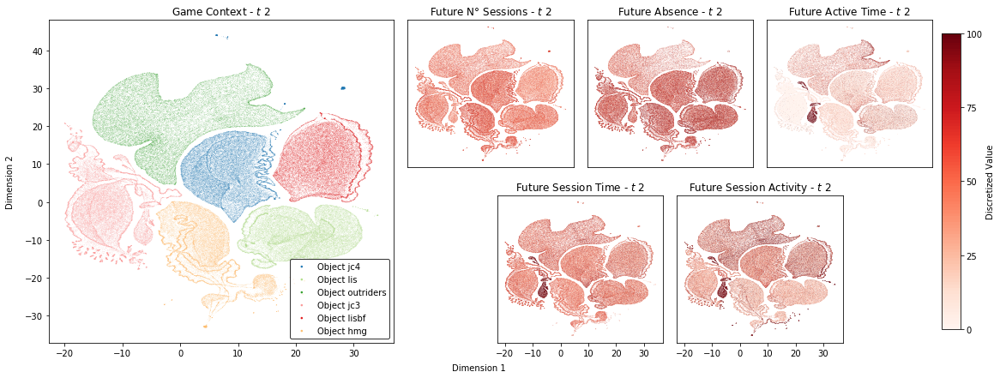

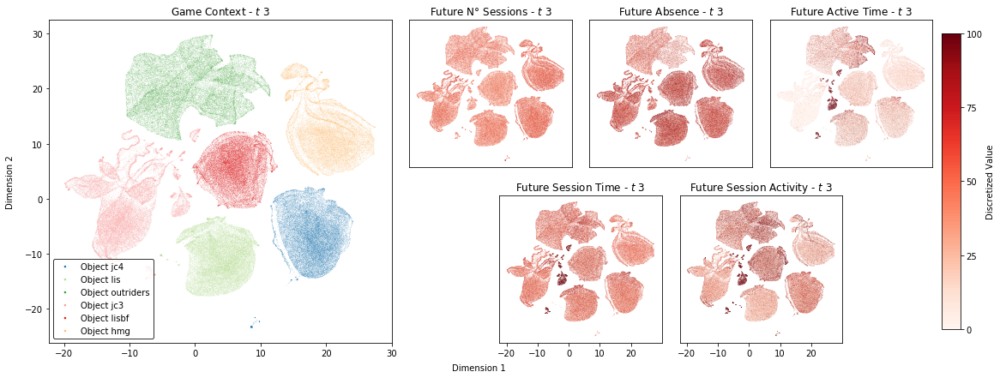

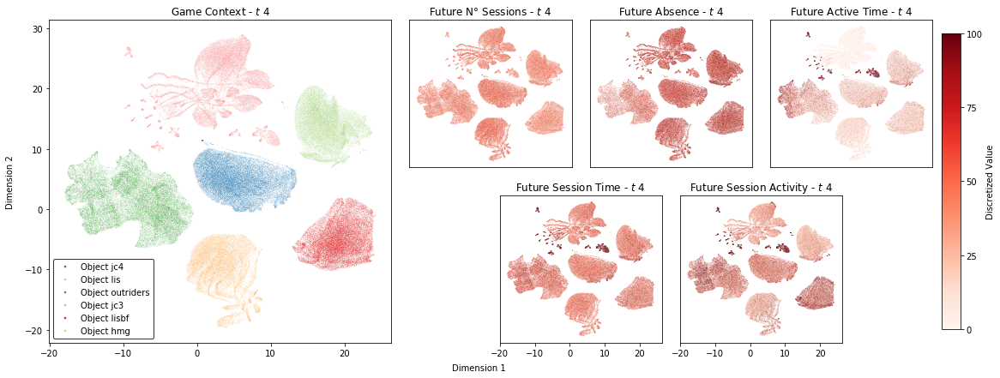

In [12]:
for snapshot in range(4):
    
    reduction = np.load(f'results\\saved_dim_reduction\\RNN_env_even_0_lstm_layer_features\\2D\\umap{snapshot}.npy')
    reduction = reduction[~np.isnan(reduction).any(axis=1)]
    colors_dict = {target_name: None for target_name in TARGETS}

    for color_name, array in colors_dict.items():

        colors_dict[color_name] = container['error']['RNN_env_even'][color_name][snapshot] * 100
        
    visualize_full_panel(
        reduction=reduction, 
        contexts=container['context'][snapshot],
        context_remap=CONTEXT_RMP,
        colors_dict=colors_dict, 
        colors_remap=TARGETS_RMP,
        colors_name=TARGETS, 
        cmapper=CMAP,
        snapshot=snapshot+1,
        scatter_cmapper='Reds',
        save_name=f'full_umap_beh_error_{snapshot}',
        s=0.1
    )

### ENVIRONMENT REPRESENTATION

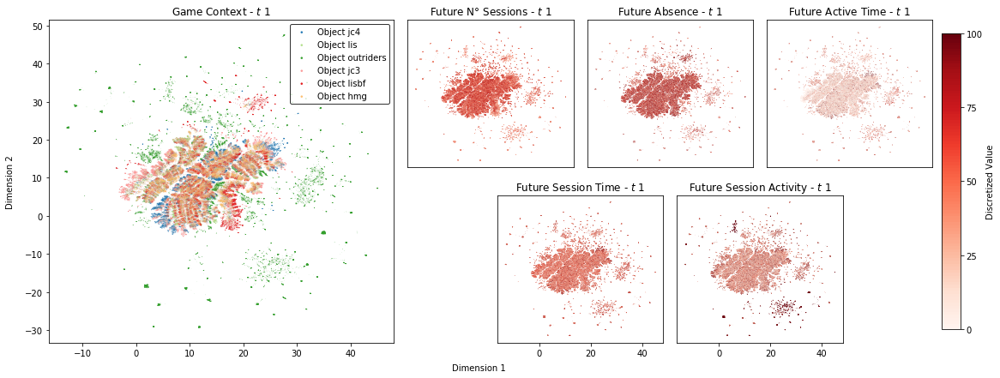

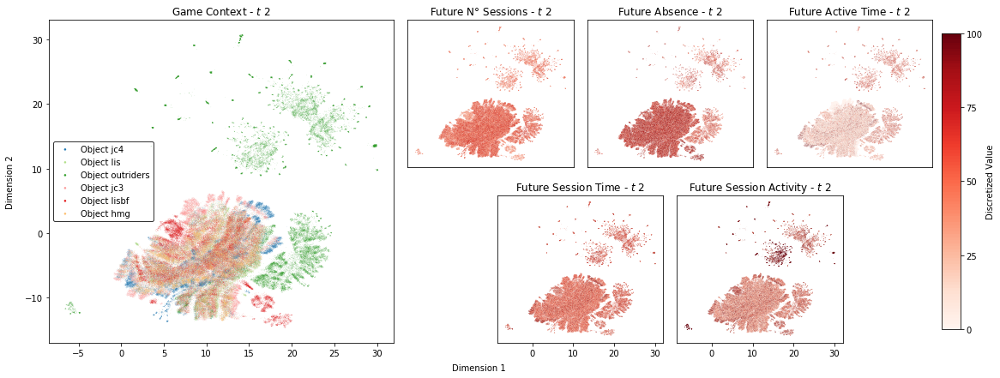

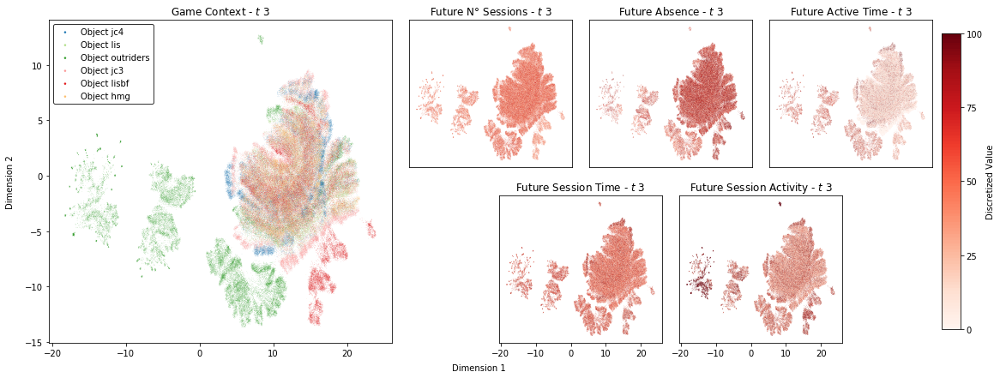

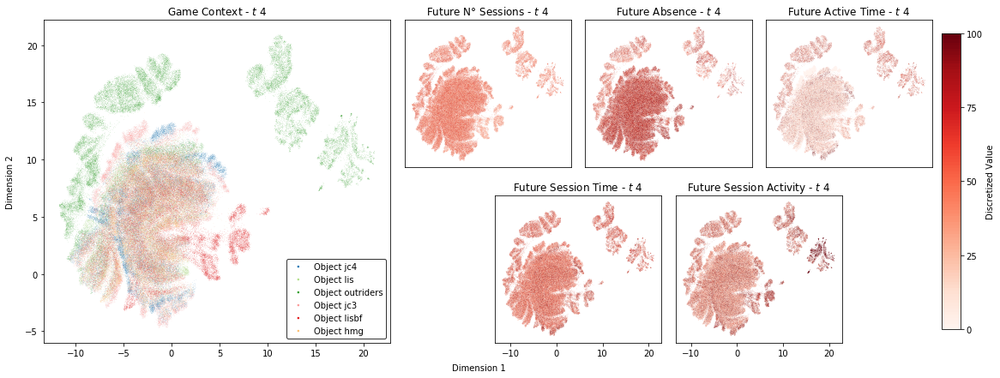

In [14]:
for snapshot in range(4):
    
    reduction = np.load(f'results\\saved_dim_reduction\\RNN_env_even_0_lstm_layer_env\\2D\\umap{snapshot}.npy')
    reduction = reduction[~np.isnan(reduction).any(axis=1)]
    colors_dict = {target_name: None for target_name in TARGETS}

    for color_name, array in colors_dict.items():

        colors_dict[color_name] = container['error']['RNN_env_even'][color_name][snapshot] * 100
        
    visualize_full_panel(
        reduction=reduction, 
        contexts=container['context'][snapshot],
        context_remap=CONTEXT_RMP,
        colors_dict=colors_dict, 
        colors_remap=TARGETS_RMP,
        colors_name=TARGETS, 
        cmapper=CMAP,
        snapshot=snapshot+1,
        scatter_cmapper='Reds',
        save_name=f'full_umap_env_error_{snapshot}',
        s=0.1
    )

### GAME EVENTS REPRESENTATION

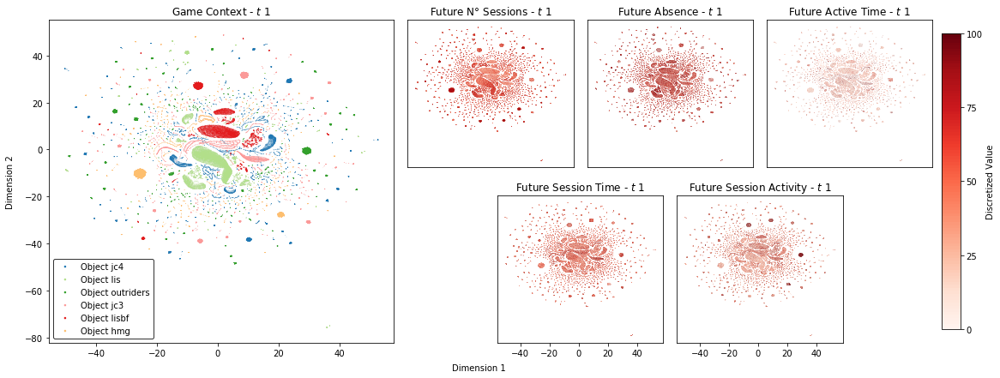

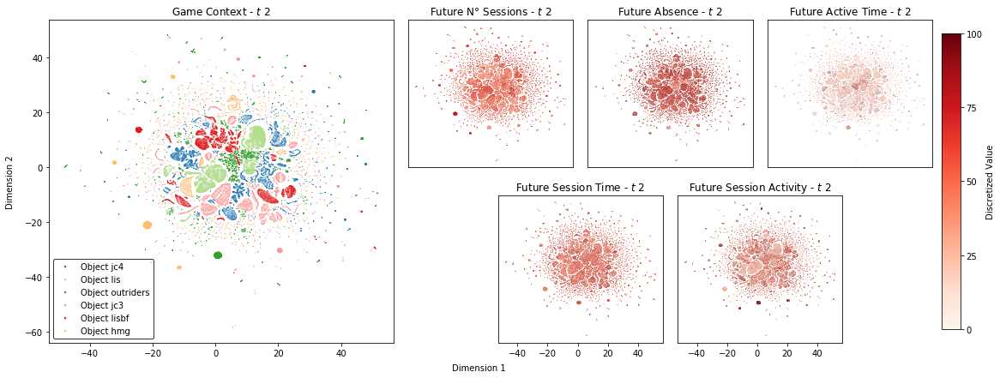

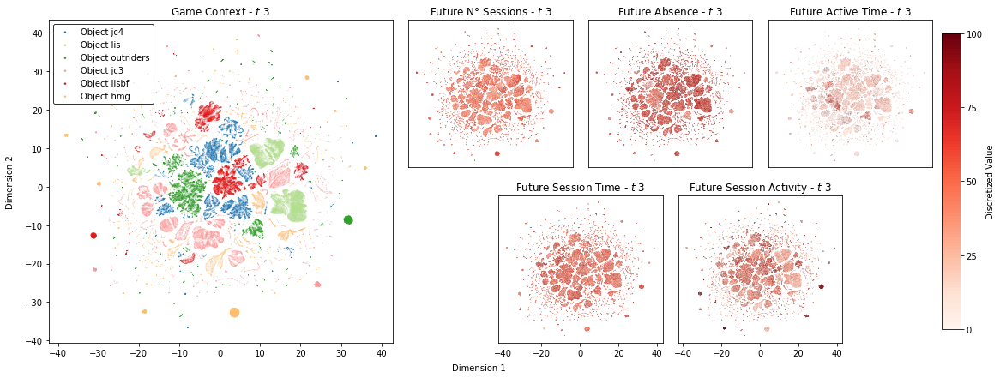

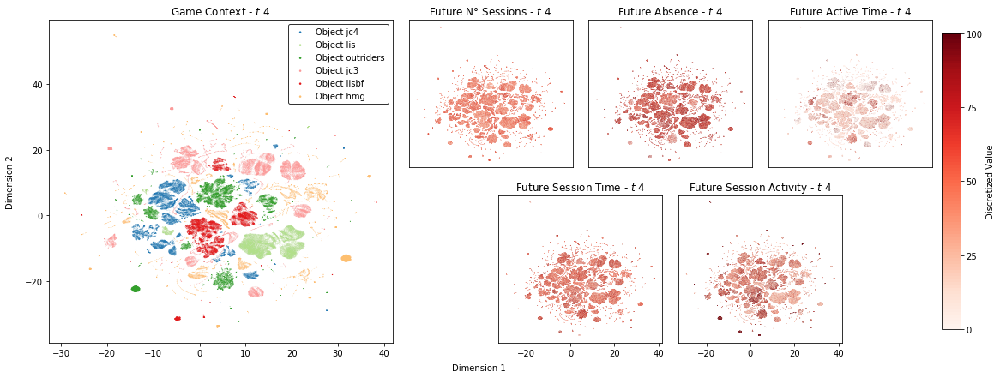

In [15]:
for snapshot in range(4):
    
    reduction = np.load(f'results\\saved_dim_reduction\\RNN_env_even_0_lstm_layer_events\\2D\\umap{snapshot}.npy')
    reduction = reduction[~np.isnan(reduction).any(axis=1)]
    colors_dict = {target_name: None for target_name in TARGETS}

    for color_name, array in colors_dict.items():

        colors_dict[color_name] = container['error']['RNN_env_even'][color_name][snapshot] * 100
        
    visualize_full_panel(
        reduction=reduction, 
        contexts=container['context'][snapshot],
        context_remap=CONTEXT_RMP,
        colors_dict=colors_dict, 
        colors_remap=TARGETS_RMP,
        colors_name=TARGETS, 
        cmapper=CMAP,
        snapshot=snapshot+1,
        scatter_cmapper='Reds',
        save_name=f'full_umap_even_error_{snapshot}',
        s=0.1
    )

## ERRORS DIFFERENTIALS PLAYER STATE

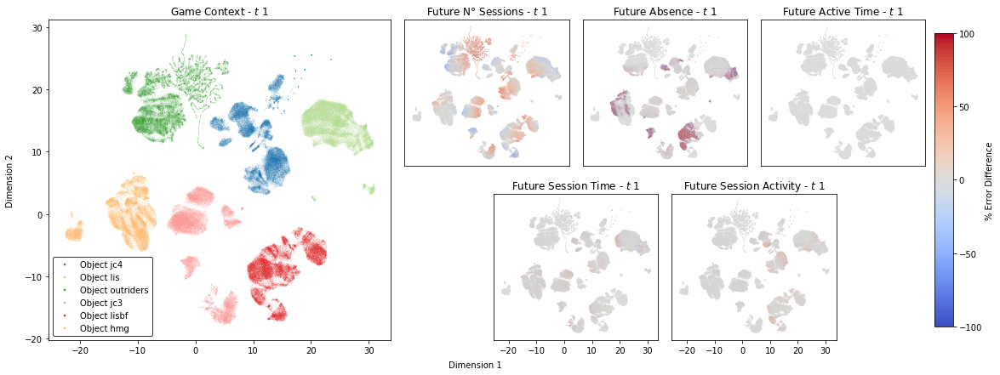

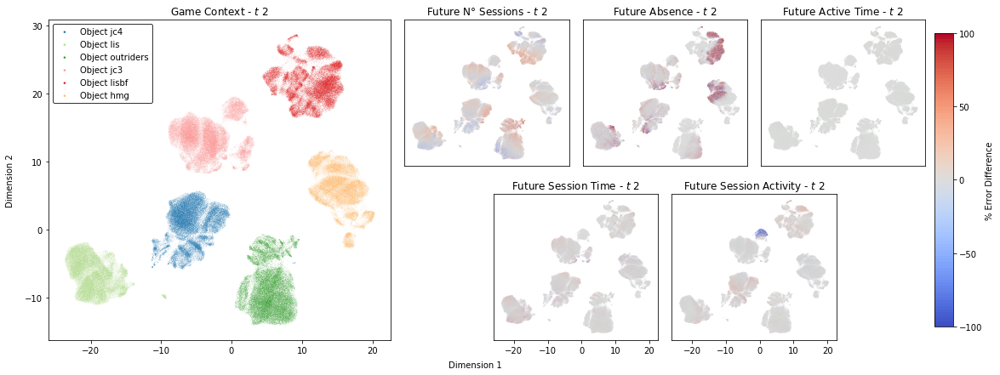

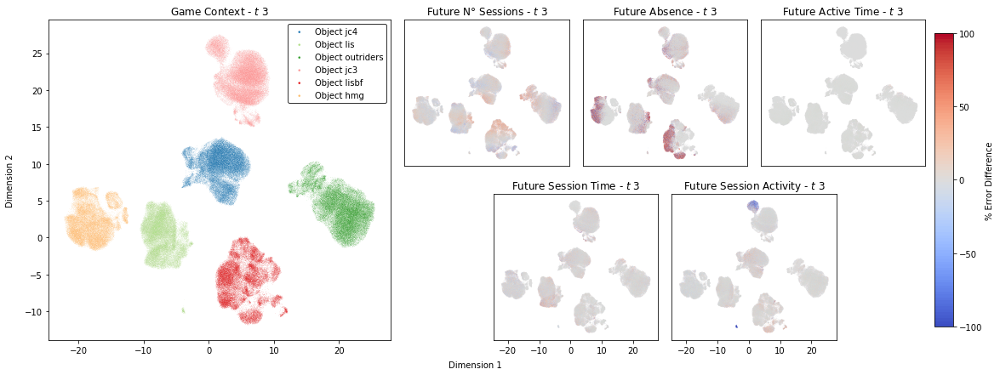

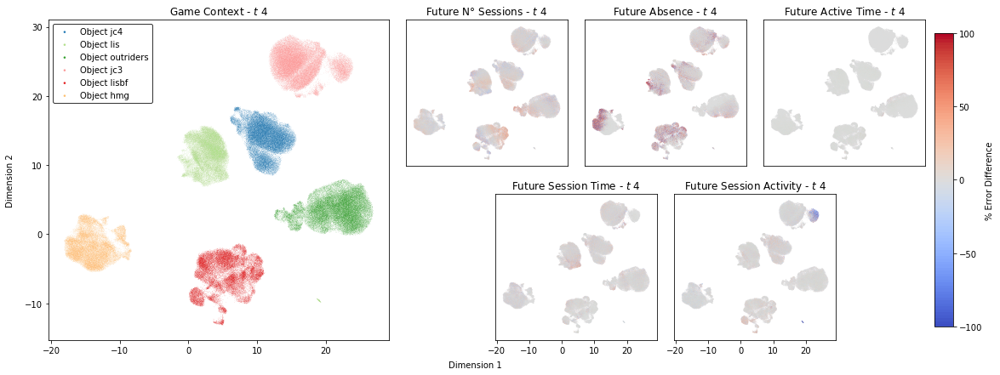

In [16]:
for snapshot in range(4):
    
    reduction = np.load(f'results\\saved_dim_reduction\\RNN_env_even_0_lstm_layer_shared\\2D\\umap{snapshot}.npy')
    reduction = reduction[~np.isnan(reduction).any(axis=1)]
    colors_dict = {target_name: None for target_name in TARGETS}

    for color_name, array in colors_dict.items():

        colors_dict[color_name] = (
            container['error']['RNN'][color_name][snapshot] - container['error']['RNN_env_even'][color_name][snapshot] 
        ) * 100
        
    visualize_full_panel(
        reduction=reduction, 
        contexts=container['context'][snapshot],
        context_remap=CONTEXT_RMP,
        colors_dict=colors_dict, 
        colors_remap=TARGETS_RMP,
        colors_name=TARGETS, 
        cmapper=CMAP,
        scatter_cmapper='coolwarm',
        snapshot=snapshot+1,
        save_name=f'full_umap_state_error_diff_{snapshot}',
        scatter_cmap_name='% Error Difference',
        vmin_sc=-100,
        vmax_sc=100,
        s=0.1
    )